In [ ]:
import cv2
import os, shutil
import random
import numpy as np
from sklearn.preprocessing import LabelEncoder
from matplotlib import pyplot as plt
import tensorflow as tf
import keras
import keras.backend as K
from keras.utils import np_utils
from tensorflow.keras import models

import tensorflow as tf
tf.test.is_gpu_available()
#tf.test.is_built_with_cuda()

from tensorflow.python.client import device_lib
from tensorflow.keras.models import Model
from tensorflow.keras import layers
import pandas as pd
from tensorflow.keras.utils import to_categorical
import cv2
import os
from os import listdir
import cv2
import numpy as np
import pickle
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split
from keras.applications.vgg16 import VGG16
from keras.layers import Input, Flatten, Dense, Dropout
from keras.models import Model
from keras.callbacks import ModelCheckpoint
import matplotlib.pyplot as plt
import random
from keras.preprocessing.image import ImageDataGenerator
from google.colab.patches import cv2_imshow
!pip install -q -U keras-tuner
import keras_tuner as kt
from keras.optimizers import adam_v2
import tensorflow as tf
from tensorflow import keras
from keras.optimizers import adam_v2
from tensorflow.keras.layers import Dense, Activation, Dropout, Flatten
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import MaxPooling2D
!pip install keras-flops
from keras_flops import get_flops
!pip install lime
import matplotlib.image as mpimg
from lime import lime_image
from skimage.segmentation import mark_boundaries

Instructions for updating:
Use `tf.config.list_physical_devices('GPU')` instead.
     |████████████████████████████████| 135 kB 26.9 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 275 kB 29.4 MB/s 
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283857 sha256=7250ba80778bdbc179c7d8c7c75261e91880c89c704d5260f7bcac80bf18d014
  Stored in directory: /root/.cache/pip/wheels/ca/cb/e5/ac701e12d365a08917bf4c6171c0961bc880a8181359c66aa7
Successfully built lime


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#Data

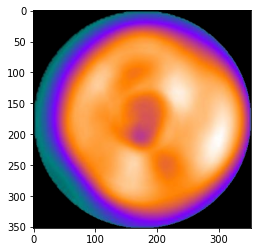

In [ ]:
imgRootDir = "./drive/MyDrive/Explainable/New_RawAC/"
imgDirPaths = [path for path in os.listdir(imgRootDir)]

#Lấy ra đường dẫn đến ảnh
#imgPaths = list(map(lambda path : os.path.join(imgRootDir, path, "stress.jpg"), imgDirPaths))

#Đọc ảnh
for imgDirPath in imgDirPaths:
  # read input
  img = cv2.imread(os.path.join(imgRootDir, imgDirPath, 'stress.jpg'))

  # convert to gray
  gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

  # threshold and invert
  #thresh = cv2.threshold(gray, 155, 255, cv2.THRESH_BINARY)[1]
  thresh = cv2.threshold(gray, 160, 255, cv2.THRESH_BINARY)[1]

  # apply morphology close
  kernel = np.ones((3, 3), np.uint8)
  thresh = cv2.morphologyEx(thresh, cv2.MORPH_DILATE, kernel)

  # get contours and filter to keep only small regions
  mask = np.zeros_like(gray, dtype=np.uint8)
  cntrs = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
  cntrs = cntrs[0] if len(cntrs) == 2 else cntrs[1]
  for c in cntrs:
      area = cv2.contourArea(c)
      if area < 1000:
          cv2.drawContours(mask, [c], 0, 255, -1)

  # do inpainting
  result = cv2.inpaint(img, mask, 3, cv2.INPAINT_TELEA)
  img = result
  # img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  #Crop ảnh
  #Crop ảnh
  croped_img = img[51:403,102:454]
  #plt.imshow(croped_img)
  radius = 176
  cx, cy = radius, radius # The center of circle
  x,y = np.ogrid[-radius: radius, -radius: radius]
  index = x**2 + y**2 > radius**2
  croped_img[cy-radius:cy+radius, cx-radius:cx+radius][index] = 0
  #plt.imshow(croped_img)

  croped_img2=cv2.cvtColor(croped_img, cv2.COLOR_BGR2RGB)
  plt.imshow(croped_img2)
  cv2.imwrite(os.path.join(imgRootDir, imgDirPath, 'croped_circle.jpg'), cv2.cvtColor(croped_img2, cv2.COLOR_BGR2RGB))

#Lấy đường dẫn ảnh sau khi đã crop
imgPaths = list(map(lambda path : os.path.join(imgRootDir, path, 'croped_circle.jpg'), imgDirPaths))
#print(imgPaths)

In [ ]:
#Hàm lấy dòng đầu tiên của file txt đầu tiên
def getText(dirName):
  #Chỉ lấy file .txt tạo thành 1 list mới
  #join ghép imgRootDir và dirName thành 1 đường dẫn mới
  fileName = list(filter(lambda textPath : textPath[-4:] == '.txt', os.listdir(os.path.join(imgRootDir, dirName))))[0] 
  #Mở file txt
  with open(os.path.join(imgRootDir, dirName, fileName), 'r') as fd:
    firstLine = fd.readline() #Lấy dòng đầu tiên
  
  return firstLine.rstrip() # rstrip bỏ ký tự cuối cùng là \n

#Chuyển đổi list thư mục trong Raw_sample thành 1 list mới là các labels
labels = list(map(getText, imgDirPaths)) 
print(labels[0:5])

#Chuyển labels thành số
le = LabelEncoder()
labels = le.fit_transform(labels)
#labels = to_categorical(labels)
print(labels[0:5])

['khong-co-benh', 'co-benh', 'khong-co-benh', 'co-benh', 'khong-co-benh']
[1 0 1 0 1]


In [ ]:
import numpy as np
from keras.preprocessing.image import img_to_array
from keras.applications import imagenet_utils
from keras.preprocessing.image import load_img

#Load ảnh và resize lại đứng kích thước mà VGG16 cần
list_image = []
list_image_org = []
for (j, imagePath) in enumerate(imgPaths):
  image = load_img(imagePath, target_size=(224, 224))
  list_image_org.append(image)#Dùng để hiển thị cuối
  image = img_to_array(image) #Chuyển ảnh về ma trận  
  image = np.expand_dims(image, 0) #Bao quanh bên ngoài ma trận bằng số 0   
  #list_image_org.append(image)
  # Scale inputs to [-1, +1]
  #image =tf.keras.applications.xception.preprocess_input(image)
    
  image = imagenet_utils.preprocess_input(image) #Làm đầy ảnh để có được kích thước như yêu cầu
  #image = tf.keras.applications.inception_v3.preprocess_input(image)
  #image = tf.keras.applications.vgg16.preprocess_input(image)
  #image = tf.keras.applications.resnet_v2.preprocess_input(image)

  list_image.append(image)

list_image = np.vstack(list_image) #Xếp các mảng theo trình tự theo chiều dọc
#list_image_org = np.vstack(list_image_org) #Xếp các mảng theo trình tự theo chiều dọc

print(list_image.shape)
print(list_image[0][0][0])

(218, 224, 224, 3)
[-103.939 -116.779 -123.68 ]


In [ ]:
from sklearn.model_selection import train_test_split

# Chia traing set, test set tỉ lệ 80-20
X_train, X_test, y_train, y_test = train_test_split(list_image, labels, test_size=0.2, random_state=43)
X_train2, X_test2, y_train2, y_test2 = train_test_split(list_image_org, labels, test_size=0.2, random_state=43)

In [ ]:
X_train = X_train.astype('float')/255.0
X_test  = X_test.astype('float')/255.0

In [ ]:
label = ["co-benh","khong-benh"]

In [ ]:
# Load mô hình và bộ trọng số
teacher = keras.models.load_model(filepath='./drive/MyDrive/Explainable/models/bestmodel.h5')
best_weight = "./drive/MyDrive/Explainable/models/weights.hdf5"
teacher.load_weights(best_weight)
teacher.evaluate(X_test,y_test)

2/2 [==============================] - 14s 757ms/step - loss: 0.2003 - acc: 0.9545


[0.2003430426120758, 0.9545454382896423]

In [ ]:
teacher.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                              

In [ ]:
y_pred = teacher.predict(X_test)

In [ ]:
predict = []
for x in y_pred:
  predict.append(np.argmax(x))

In [ ]:
from sklearn.metrics import confusion_matrix
arr = confusion_matrix(y_test, predict)

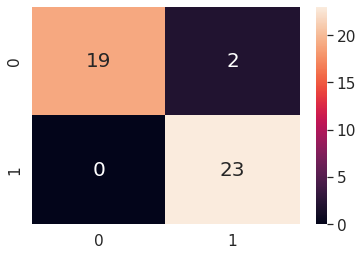

In [ ]:
import seaborn as sn
import pandas as pd
import matplotlib.pyplot as plt
df_cm = pd.DataFrame(arr, range(2), range(2))
# plt.figure(figsize=(10,7))
sn.set(font_scale=1.4) # for label size
sn.heatmap(df_cm, annot=True, annot_kws={"size": 20}) # font size

plt.show()

In [ ]:
import tensorflow.keras as keras
import tensorflow as tf
from tensorflow.keras import layers

class Distiller(keras.Model):
    def __init__(self, student, teacher):
      """
      teacher: teacher model
      student: student model
      """
      super(Distiller, self).__init__()
      self.teacher = teacher
      self.student = student

    def compile(
      self,
      optimizer,
      metrics,
      student_loss_fn,
      distillation_loss_fn,
      alpha=0.1,
      temperature=3,
    ):
      """ Configure the distiller.

      Args:
          optimizer: Keras optimizer for the student weights
          metrics: Keras metrics for evaluation
          student_loss_fn: Loss function of difference between student
              predictions and ground-truth
          distillation_loss_fn: Loss function of difference between soft
              student predictions and soft teacher predictions
          alpha: weight to student_loss_fn and 1-alpha to distillation_loss_fn
          temperature: Temperature for softening probability distributions.
              Larger temperature gives softer distributions.
      """
      super(Distiller, self).compile(optimizer=optimizer, metrics=metrics)
      self.student_loss_fn = student_loss_fn
      self.distillation_loss_fn = distillation_loss_fn
      self.alpha = alpha
      self.temperature = temperature

    def train_step(self, data):
      # Unpack data
      x, y = data

      # Forward pass of teacher
      teacher_predictions = self.teacher(x, training=False)

      with tf.GradientTape() as tape:
          # Forward pass of student
          student_predictions = self.student(x, training=True)

          # Compute losses
          student_loss = self.student_loss_fn(y, student_predictions)
          distillation_loss = self.distillation_loss_fn(
              tf.nn.softmax(teacher_predictions / self.temperature, axis=1), # soft label from teacher 
              tf.nn.softmax(student_predictions / self.temperature, axis=1), # soft prediction from student
          )
          loss = self.alpha * student_loss + (1 - self.alpha) * distillation_loss

      # Compute gradients
      trainable_vars = self.student.trainable_variables
      gradients = tape.gradient(loss, trainable_vars)

      # Update weights
      self.optimizer.apply_gradients(zip(gradients, trainable_vars))

      # Update the metrics configured in `compile()`.
      self.compiled_metrics.update_state(y, student_predictions)

      # Return a dict of performance
      results = {m.name: m.result() for m in self.metrics}
      results.update(
          {"student_loss": student_loss, "distillation_loss": distillation_loss}
      )
      return results

    def test_step(self, data):
      # Unpack the data
      x, y = data

      # Compute predictions
      y_prediction = self.student(x, training=False)

      # Calculate the loss
      student_loss = self.student_loss_fn(y, y_prediction)

      # Update the metrics.
      self.compiled_metrics.update_state(y, y_prediction)

      # Return a dict of performance
      results = {m.name: m.result() for m in self.metrics}
      results.update({"student_loss": student_loss})
      return results

In [ ]:
import time
def predict_time(model):
  import time
  image = np.expand_dims(X_test[5], axis=0)
  start_time = time.time()
  predict = model.predict(image)
  print("--- %s seconds ---" % (time.time() - start_time))

In [ ]:
def predict(idx,best_model):
  image = np.expand_dims(X_test[idx], axis=0)
  return best_model.predict(image)

In [ ]:
explainer = lime_image.LimeImageExplainer()

In [ ]:
explanation = explainer.explain_instance(X_test[1], teacher.predict, top_labels=2, hide_color=0, num_samples=1000)

  0%|          | 0/1000 [00:00<?, ?it/s]

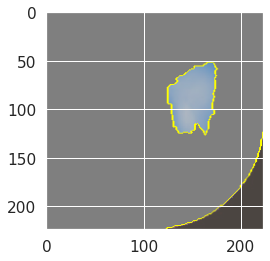

In [ ]:
from skimage.segmentation import mark_boundaries
temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=True, num_features=2, hide_rest=True)
plt.imshow(mark_boundaries((temp / 2 + 0.5), mask))

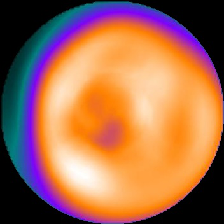

In [ ]:
X_test2[1]

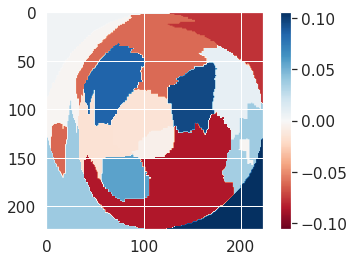

In [ ]:
#Select the same class explained on the figures above.
ind =  explanation.top_labels[0]

#Map each explanation weight to the corresponding superpixel
dict_heatmap = dict(explanation.local_exp[ind])
heatmap = np.vectorize(dict_heatmap.get)(explanation.segments) 

#Plot. The visualization makes more sense if a symmetrical colorbar is used.
plt.imshow(heatmap, cmap = 'RdBu', vmin  = -heatmap.max(), vmax = heatmap.max())
plt.colorbar()

#LIME

In [ ]:
def runLime(model):
  co_benh = 0
  khong_benh = 0
  for i in range(len(X_test)):
    print(khong_benh)
    if co_benh >2 and khong_benh>2:
      break
    else:
      preds = predict(i,model)
      result = np.argmax(preds)
      if(result==y_test[i]):
        if result == 0:
          co_benh +=1
        elif result ==1:
          khong_benh +=1
        explain(i,model)
      else:
        continue
   



def explain(idx,best_model):

  preds = predict(idx,best_model)

  explainer = lime_image.LimeImageExplainer()
  explanation = explainer.explain_instance(X_test[idx], best_model.predict, top_labels=2,  num_samples=1000)

  index_0 = explanation.top_labels[0]
  index_1 = explanation.top_labels[1]

  
  fig = plt.figure(figsize=(15, 10))
  fig.add_subplot(131)

  temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=True, num_features=5, hide_rest=True)
  plt.imshow(mark_boundaries(X_test2[idx], mask))


  plt.title(label[index_0]+' prob: '+str(preds[0][index_0]))
  plt.axis('off')

  fig.add_subplot(133)


  temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], negative_only=True, positive_only=False, num_features=5, hide_rest=True)
  plt.imshow(mark_boundaries(X_test2[idx]   , mask))


  plt.title(label[index_1]+ ' prob: '+str(preds[0][index_1]))
  plt.axis('off')



  fig.add_subplot(132)
    #Select the same class explained on the figures above.
  ind =  explanation.top_labels[0]

  dict_heatmap = dict(explanation.local_exp[ind])
  heatmap = np.vectorize(dict_heatmap.get)(explanation.segments) 
  plt.title('heatmap')
  plt.imshow(heatmap, cmap = 'RdBu', vmin  = -heatmap.max(), vmax = heatmap.max(),alpha=1.0)
  plt.imshow(X_test2[idx],alpha = 0.5)
  plt.axis('off')
  plt.show()

#Grad-CAM

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow import keras

# Display
from IPython.display import Image, display
import matplotlib.pyplot as plt
import matplotlib.cm as cm

In [ ]:
def get_img_array(image):
  # image = cv2.imread(img_path)
  # image = cv2.resize(image,(224,224))
  # image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
  image = np.expand_dims(image, axis=0)
  # image = image.astype('float')/255.0
  return image

def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    # First, we create a model that maps the input image to the activations
    # of the last conv layer as well as the output predictions
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )

    # Then, we compute the gradient of the top predicted class for our input image
    # with respect to the activations of the last conv layer
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    # This is the gradient of the output neuron (top predicted or chosen)
    # with regard to the output feature map of the last conv layer
    grads = tape.gradient(class_channel, last_conv_layer_output)

    # This is a vector where each entry is the mean intensity of the gradient
    # over a specific feature map channel
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    # We multiply each channel in the feature map array
    # by "how important this channel is" with regard to the top predicted class
    # then sum all the channels to obtain the heatmap class activation
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    # For visualization purpose, we will also normalize the heatmap between 0 & 1
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

In [ ]:
def grad_cam(idx, model, last_conv_layer_name):


  pred = predict(idx,model)
  
  index_0 = np.argmax(pred)

  img_array = get_img_array(X_test[idx])

  # Generate class activation heatmap
  heatmap = make_gradcam_heatmap(img_array, model,last_conv_layer_name)
  heatmap = cv2.resize(heatmap,(224,224))



  # image = cv2.imread(img_path)
  # image = cv2.resize(image,(224,224))
  # image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
  fig = plt.figure(figsize=(15, 10))
  fig.add_subplot(131)
  plt.title(label[index_0]+' prob: '+str(pred[0][index_0]))
  plt.imshow(X_test2[idx])
  plt.axis('off')

  fig.add_subplot(132)
  plt.imshow(heatmap)
  plt.axis('off')

  fig.add_subplot(133)
  plt.imshow(heatmap)
  plt.imshow(X_test2[idx],alpha = 0.3)
  plt.axis('off')
  plt.show()

In [ ]:
def runGrad(model,last_conv):
  co_benh = 0
  khong_benh = 0
  for i in range(len(X_test)):
    print(khong_benh)
    if co_benh >2 and khong_benh>2:
      break
    else:
      preds = predict(i,model)
      result = np.argmax(preds)
      if(result==y_test[i]):
        if result == 0:
          co_benh +=1
        elif result ==1:
          khong_benh +=1
        grad_cam(i,model,last_conv)
      else:
        continue
    

#RISE

In [ ]:
!git clone https://github.com/palatos/RISE_tf

Cloning into 'RISE_tf'...
remote: Enumerating objects: 52, done.
remote: Counting objects: 100% (52/52), done.
remote: Compressing objects: 100% (42/42), done.
remote: Total 52 (delta 14), reused 43 (delta 10), pack-reused 0
Unpacking objects: 100% (52/52), done.


In [ ]:
import tensorflow as tf
from PIL import Image
import numpy as np
from matplotlib import pyplot as plt

In [ ]:
from RISE_tf.explain_image import RISE

In [ ]:
def explain_rise(model,idx):
  pred = predict(idx,model)
  explainer = RISE()
  heatmaps, masks = explainer.explain(X_test[idx],model)
  class_idx = np.argmax(pred)

  fig = plt.figure(figsize=(15, 10))
  index_0 = np.argmax(pred)
  fig.add_subplot(131)
  plt.title(label[index_0]+' prob: '+str(pred[0][index_0]))
  plt.imshow(X_test2[idx])
  plt.axis('off')
  fig.add_subplot(132)
  plt.imshow(heatmaps[class_idx],cmap='jet')
  plt.axis('off')
  fig.add_subplot(133)
  plt.imshow(heatmaps[class_idx],cmap='jet')
  plt.imshow(X_test2[idx],alpha=0.6)
  plt.axis('off')
  plt.show()


In [ ]:
def run_rise(model):
  co_benh = 0
  khong_benh = 0
  for i in range(len(X_test)):
    print(khong_benh)
    if co_benh >2 and khong_benh>2:
      break
    else:
      preds = predict(i,model)
      
      result = np.argmax(preds)
      
      if(result==y_test[i]):
        if result == 0:
          co_benh +=1
        elif result ==1:
          khong_benh +=1
        explain_rise(model,i)
      else:
        continue
   

#Evaluate all

In [ ]:
from sklearn.metrics import confusion_matrix,accuracy_score, roc_curve, auc
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
import sklearn
def evaluate_all(best_model):


  predictions_NN_prob = best_model.predict(X_test)
  predictions_NN_prob = predictions_NN_prob[:,0]
  predictions_NN_01 = np.where(predictions_NN_prob > 0.5, 1, 0)
  #Print accuracy
  acc_NN = accuracy_score(y_test, predictions_NN_01)
  print('Overall accuracy of Neural Network model:', acc_NN)
  #Print Area Under Curve
  false_positive_rate, recall, thresholds = roc_curve(y_test, predictions_NN_prob)
  print(recall)


  y_preds = []
  for i in range(len(X_test)):
    image = np.expand_dims(X_test[i], axis=0)
    predict = best_model.predict(image)
    y_preds.append(np.argmax(predict))
  y_true = []
  for i in y_test:
    y_true.append(i)
  sklearn.metrics.confusion_matrix(y_true, y_preds)
  def auc(y_true, y_pred):
      auc = tf.metrics.auc(y_pred,y_true)[1]
      K.get_session().run(tf.local_variables_initializer())
      return auc
  from sklearn.metrics import roc_auc_score
  def auc_roc(y_true, y_pred):
      return tf.py_function(roc_auc_score, (y_true, y_pred), tf.double)
  print('AUC_Glob: ',auc_roc(y_true,y_preds).numpy())


  y_hat = best_model.predict(X_test)
  print(y_hat.shape)
  y_pred = np.argmax(y_hat, axis=1)
  print(y_pred.shape)
  # print(y_test)
  # y_test_label = np.argmax(y_test, axis=-1)
  y_test_label = y_test
  print(y_test_label.shape)

  # Tính accuracy: (tp + tn) / (p + n)
  accuracy = accuracy_score(y_test_label, y_pred)
  print('Accuracy: %f' % accuracy)
  # Tính precision tp / (tp + fp)
  precision = precision_score(y_test_label, y_pred, average='macro')
  print('Precision: %f' % precision)
  # Tính recall: tp / (tp + fn)
  recall = recall_score(y_test_label, y_pred, average='macro')
  print('Recall: %f' % recall)
  # Tính f1: 2 tp / (2 tp + fp + fn)
  f1 = f1_score(y_test_label, y_pred, average='macro')
  print('F1 score: %f' % f1)

  tn, fp, fn, tp = confusion_matrix(y_test_label, y_pred).ravel()
  tnr = tn/(tn + fp)
  print("Specificity: %f" % tnr)

#Distillation with VGG16

**create model**

In [ ]:
def vgg_16():
    model_vgg16_conv = VGG16(weights='imagenet', include_top=False)

    # Dong bang cac layer
    for layer in model_vgg16_conv.layers:
        layer.trainable = False

    # Tao model
    input = Input(shape=(224, 224, 3), name='image_input')
    output_vgg16_conv = model_vgg16_conv(input)
    # Them cac layer FC va Dropout
    x = tf.keras.layers.GlobalAveragePooling2D()(output_vgg16_conv)
    x = Dense(256, activation='relu')(x)
    x = Dropout(0.2)(x)
    x = Dense(2, activation='softmax', name='predictions')(x)
    optim_1 = adam_v2.Adam(learning_rate= 0.001)
    # Compile
    my_model = Model(inputs=input, outputs=x)
    my_model.compile(loss='sparse_categorical_crossentropy', optimizer=optim_1, metrics=[keras.metrics.SparseCategoricalAccuracy()])

    return my_model

In [ ]:
vgg_16 = vgg_16()
student = keras.models.clone_model(vgg_16)

**Distilltion**

In [ ]:
distiller = Distiller(student=vgg_16, teacher=teacher)

distiller.compile(
    optimizer=keras.optimizers.Adam(),
    metrics=[keras.metrics.SparseCategoricalAccuracy()],
    student_loss_fn=keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=keras.losses.KLDivergence(),
    alpha=0.1,
    temperature=10,
)
# Distill teacher to student
max = 0.0
for i in range(100):
  history=distiller.fit(X_train, y_train,
                                epochs=1,validation_data=(X_test,y_test))
  eval = distiller.evaluate(X_test,y_test)
  if(eval[0]>max):
    max = eval[0]
    print("save weights"+ str(eval[0]))
    distiller.save_weights('./drive/MyDrive/Explainable/Distilltion/distiller_vgg16.hdf5')
distiller.built = True
distiller.load_weights('./drive/MyDrive/Explainable/Distilltion/distiller_vgg16.hdf5')
distiller.student.save('./drive/MyDrive/Explainable/Distilltion/distilled_vgg16.h5')

**Summary**

In [ ]:
distiller.student.summary()

**Evaluate**

In [ ]:
distilled_vgg16 = keras.models.load_model(filepath='./drive/MyDrive/Explainable/Distilltion/distilled_vgg16.h5')
distilled_vgg16.evaluate(X_test,y_test)
evaluate_all(distilled_vgg16)

2/2 [==============================] - 21s 5s/step - loss: 0.3344 - sparse_categorical_accuracy: 0.8636
Overall accuracy of Neural Network model: 0.13636363636363635
[0.         0.         0.         0.04347826 0.04347826 0.08695652
 0.08695652 0.13043478 0.13043478 0.17391304 0.17391304 0.52173913
 0.52173913 0.65217391 0.65217391 1.        ]
AUC_Glob:  0.8633540372670807
(44, 2)
(44,)
(44,)
Accuracy: 0.863636
Precision: 0.863354
Recall: 0.863354
F1 score: 0.863354
Specificity: 0.857143


**Flop**

In [ ]:
flops = get_flops(distilled_vgg16, batch_size=1)
print(f"FLOPS: {flops / 10 ** 9:.03} G")

Instructions for updating:
Use `tf.compat.v1.graph_util.tensor_shape_from_node_def_name`
FLOPS: 30.7 G


**InferenceTime**

In [ ]:
predict(distilled_vgg16)

--- 0.5833330154418945 seconds ---


**Student baseline**

In [ ]:
student = vgg_16()
filepath="./drive/MyDrive/Explainable/Distilltion/student_vgg16.hdf5"
checkpoint = ModelCheckpoint(filepath, monitor='val_sparse_categorical_accuracy', verbose=1, save_best_only=True, mode='max')
callbacks_list = [checkpoint]
# Train and evaluate student trained from scratch.
student.fit(X_train, y_train,
                               epochs=100,
                               validation_data=(X_test,y_test),
                               callbacks=callbacks_list)
student.built = True
student.load_weights('./drive/MyDrive/Explainable/Distilltion/student_vgg16.hdf5')
student.save('./drive/MyDrive/Explainable/Distilltion/student_vgg16.h5')

In [ ]:
student.summary()

Model: "model_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_input (InputLayer)    [(None, 224, 224, 3)]     0         
                                                                 
 vgg16 (Functional)          (None, None, None, 512)   14714688  
                                                                 
 global_average_pooling2d_13  (None, 512)              0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dense_17 (Dense)            (None, 256)               131328    
                                                                 
 dropout_15 (Dropout)        (None, 256)               0         
                                                                 
 predictions (Dense)         (None, 2)                 514       
                                                          

In [ ]:
student_vgg16 = keras.models.load_model(filepath='./drive/MyDrive/Explainable/Distilltion/student_vgg16.h5')
student_vgg16.evaluate(X_test,y_test)
evaluate_all(student_vgg16)

2/2 [==============================] - 20s 5s/step - loss: 0.3494 - sparse_categorical_accuracy: 0.8864
Overall accuracy of Neural Network model: 0.11363636363636363
[0.         0.         0.         0.04347826 0.04347826 0.13043478
 0.13043478 0.47826087 0.47826087 0.65217391 0.65217391 1.        ]
AUC_Glob:  0.8871635610766045
(44, 2)
(44,)
(44,)
Accuracy: 0.886364
Precision: 0.886364
Recall: 0.887164
F1 score: 0.886305
Specificity: 0.904762


In [ ]:
flops = get_flops(student_vgg16, batch_size=1)
print(f"FLOPS: {flops / 10 ** 9:.03} G")

FLOPS: 30.7 G


In [ ]:
predict(student_vgg16)

--- 0.5903089046478271 seconds ---


**LIME**

**LIME with Distiller**

In [ ]:
runLime(distilled_vgg16)

**LIME with Student BaseLine**

In [ ]:
runLime(student_vgg16)

#Distilltion VGG-Scratch

In [ ]:
def vgg_scratch():
  student = tf.keras.Sequential()

  student.add(Conv2D(4, (3,3), activation="relu", padding="same", kernel_initializer='he_uniform', name='block1_conv1', input_shape=(224, 224, 3)))
  student.add(Conv2D(4, (3,3), activation="relu", padding="same", kernel_initializer='he_uniform', name='block1_conv2'))
  student.add(MaxPooling2D(pool_size=(2,2), strides=(2,2), name='block1_maxpool'))

  student.add(Conv2D(8, (3,3), activation="relu", padding="same", kernel_initializer='he_uniform', name='block2_conv1'))
  student.add(Conv2D(8, (3,3), activation="relu", padding="same", kernel_initializer='he_uniform', name='block2_conv2'))
  student.add(MaxPooling2D(pool_size=(2,2), strides=(2,2), name='block2_maxpool'))

  student.add(Conv2D(16, (3,3), activation="relu", padding="same", kernel_initializer='he_uniform', name='block3_conv1'))
  student.add(Conv2D(16, (3,3), activation="relu", padding="same", kernel_initializer='he_uniform', name='block3_conv2'))
  student.add(Conv2D(16, (3,3), activation="relu", padding="same", kernel_initializer='he_uniform', name='block3_conv3'))
  student.add(MaxPooling2D(pool_size=(2,2), strides=(2,2), name='block3_maxpool'))

  student.add(Conv2D(32, (3,3), activation="relu", padding="same", kernel_initializer='he_uniform', name='block4_conv1'))
  student.add(Conv2D(32, (3,3), activation="relu", padding="same", kernel_initializer='he_uniform', name='block4_conv2'))
  student.add(Conv2D(32, (3,3), activation="relu", padding="same", kernel_initializer='he_uniform', name='block4_conv3'))
  student.add(MaxPooling2D(pool_size=(2,2), strides=(2,2), name='block4_maxpool'))

  student.add(Conv2D(64, (3,3), activation="relu", padding="same", kernel_initializer='he_uniform', name='block5_conv1'))
  student.add(Conv2D(64, (3,3), activation="relu", padding="same", kernel_initializer='he_uniform', name='block5_conv2'))
  student.add(Conv2D(64, (3,3), activation="relu", padding="same", kernel_initializer='he_uniform', name='block5_conv3'))
  student.add(MaxPooling2D(pool_size=(2,2), strides=(2,2), name='block5_maxpool'))

  student.add(Flatten())
  student.add(Dense(128, activation='relu'))
  student.add(Dropout(0.2))
  student.add(Dense(2, activation='softmax'))
  student.compile(loss='sparse_categorical_crossentropy', optimizer=optim_1, metrics=[keras.metrics.SparseCategoricalAccuracy()])

  return student

In [ ]:
vgg_scratch = vgg_scratch()

**Distilltion**

In [ ]:
distiller = Distiller(student=vgg_scratch, teacher=teacher)

distiller.compile(
    optimizer=keras.optimizers.Adam(),
    metrics=[keras.metrics.SparseCategoricalAccuracy()],
    student_loss_fn=keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=keras.losses.KLDivergence(),
    alpha=0.1,
    temperature=10,
)
# Distill teacher to student
max = 0.0
for i in range(100):
  history=distiller.fit(X_train, y_train,
                                epochs=1,validation_data=(X_test,y_test))
  eval = distiller.evaluate(X_test,y_test)
  if(eval[0]>max):
    max = eval[0]
    print("save weights"+ str(eval[0]))
    distiller.save_weights('./drive/MyDrive/Explainable/Distilltion/distiller_vgg16_scratch.hdf5')
distiller.built = True
distiller.load_weights('./drive/MyDrive/Explainable/Distilltion/distiller_vgg16_scratch.hdf5')
distiller.student.save('./drive/MyDrive/Explainable/Distilltion/distilled_vgg16_scratch.h5')

In [ ]:
distiller.student.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 block1_conv1 (Conv2D)       (None, 224, 224, 4)       112       
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 4)       148       
                                                                 
 block1_maxpool (MaxPooling2  (None, 112, 112, 4)      0         
 D)                                                              
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 8)       296       
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 8)       584       
                                                                 
 block2_maxpool (MaxPooling2  (None, 56, 56, 8)        0         
 D)                                                   

In [ ]:
distilled_vgg16_mini = keras.models.load_model(filepath='./drive/MyDrive/Explainable/Distilltion/distilled_vgg16_scratch.h5')
distilled_vgg16_mini.evaluate(X_test,y_test)
evaluate_all(distilled_vgg16_mini)

2/2 [==============================] - 1s 157ms/step - loss: 0.3719 - sparse_categorical_accuracy: 0.8636
Overall accuracy of Neural Network model: 0.13636363636363635
[0.         0.         0.         0.08695652 0.08695652 0.13043478
 0.13043478 0.26086957 0.26086957 0.65217391 0.65217391 0.86956522
 0.86956522 1.        ]
AUC_Glob:  0.8571428571428572
(44, 2)
(44,)
(44,)
Accuracy: 0.863636
Precision: 0.896552
Recall: 0.857143
F1 score: 0.858974
Specificity: 0.714286


In [ ]:
flops = get_flops(distilled_vgg16_mini, batch_size=1)
print(f"FLOPS: {flops / 10 ** 9:.03} G")

FLOPS: 0.157 G


In [ ]:
predict(distilled_vgg16_mini)

**student baseline**

In [ ]:
student = vgg_scratch()
filepath="./drive/MyDrive/Explainable/Distilltion/student_vgg16_scratch.hdf5"
checkpoint = ModelCheckpoint(filepath, monitor='val_sparse_categorical_accuracy', verbose=1, save_best_only=True, mode='max')
callbacks_list = [checkpoint]
# Train and evaluate student trained from scratch.
student.fit(X_train, y_train,
                               epochs=100,
                               validation_data=(X_test,y_test),
                               callbacks=callbacks_list)
student.built = True
student.load_weights('./drive/MyDrive/Explainable/Distilltion/student_vgg16_scratch.hdf5')
student.save('./drive/MyDrive/Explainable/Distilltion/student_vgg16_scratch.h5')

In [ ]:
student.summary()

In [ ]:
student_vgg16_mini = keras.models.load_model(filepath='./drive/MyDrive/Explainable/Distilltion/student_vgg16_scratch.h5')
student_vgg16_mini.evaluate(X_test,y_test)
evaluate_all(student_vgg16_mini)

2/2 [==============================] - 0s 13ms/step - loss: 0.3959 - sparse_categorical_accuracy: 0.8636
Overall accuracy of Neural Network model: 0.13636363636363635
[0.         0.         0.         0.2173913  0.2173913  0.56521739
 0.56521739 0.7826087  0.7826087  0.82608696 0.82608696 1.        ]
AUC_Glob:  0.8571428571428572
(44, 2)
(44,)
(44,)
Accuracy: 0.863636
Precision: 0.896552
Recall: 0.857143
F1 score: 0.858974
Specificity: 0.714286


In [ ]:
flops = get_flops(student_vgg16_mini, batch_size=1)
print(f"FLOPS: {flops / 10 ** 9:.03} G")

FLOPS: 0.157 G


In [ ]:
predict(student_vgg16_mini)

--- 0.08574700355529785 seconds ---


**RISE**

**Distilled**

0


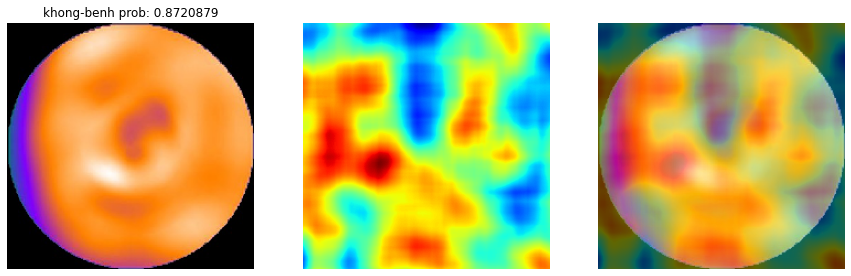

1


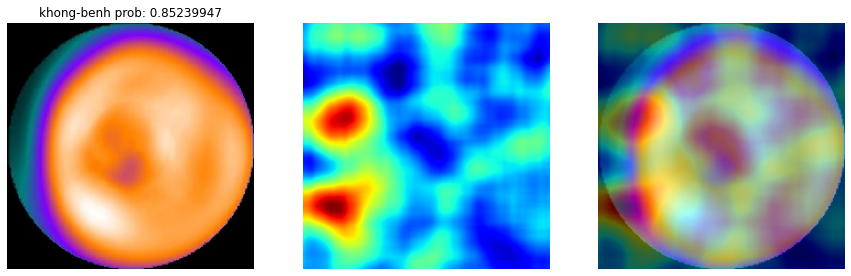

2


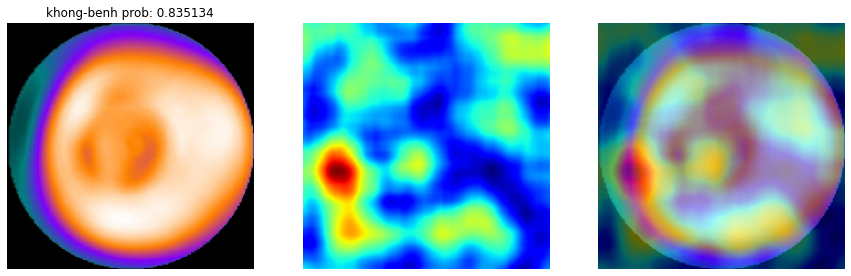

3


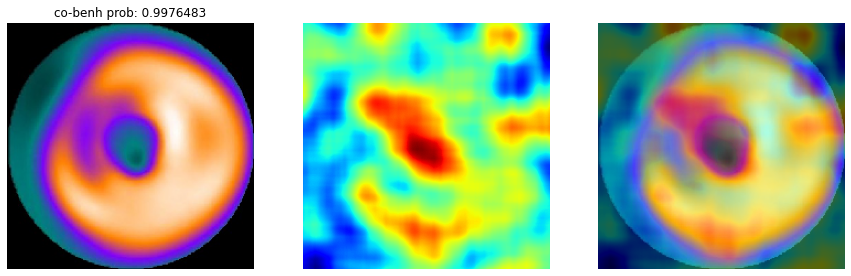

3
3
3


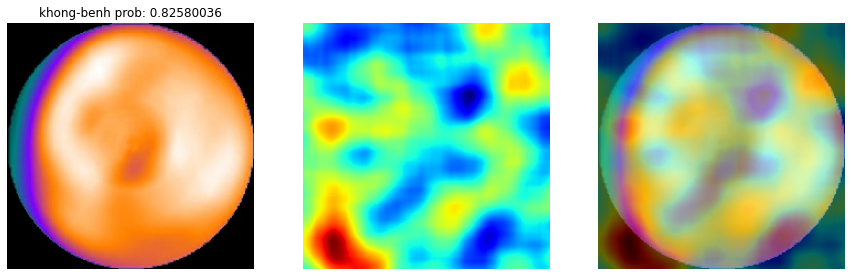

4


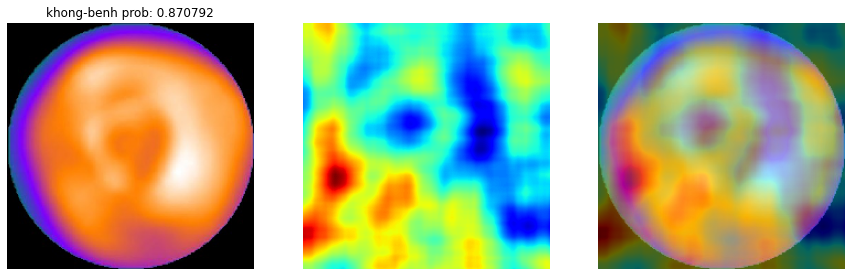

5
5


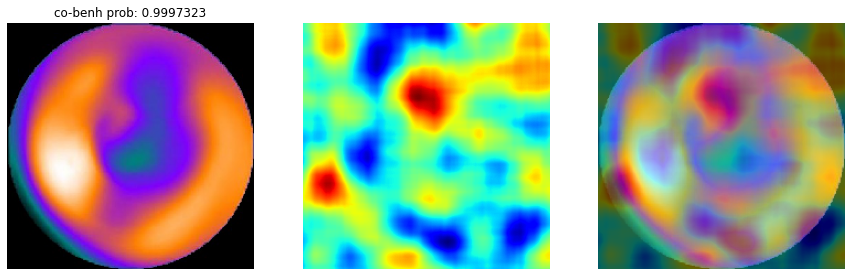

5


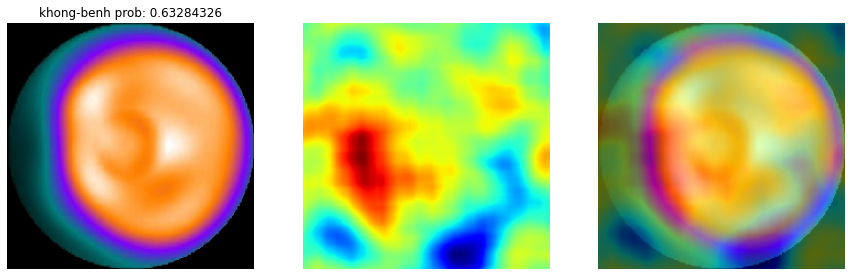

6


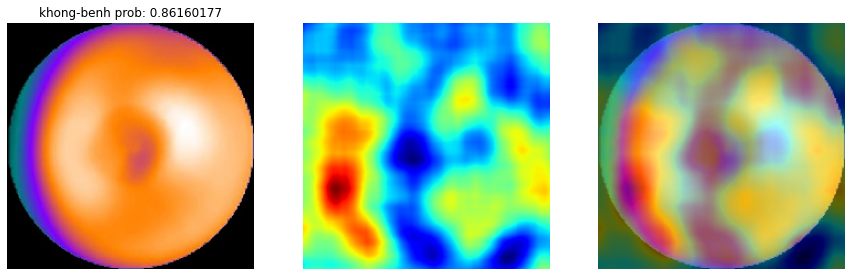

7


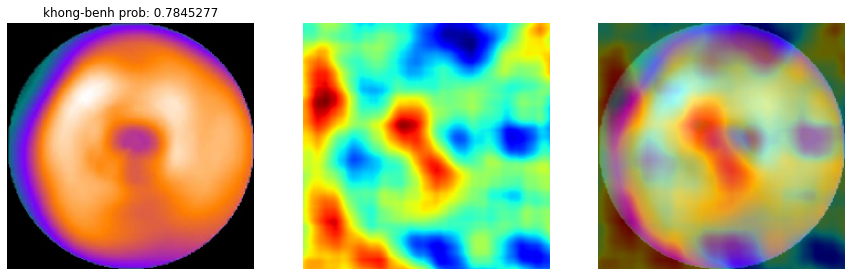

8


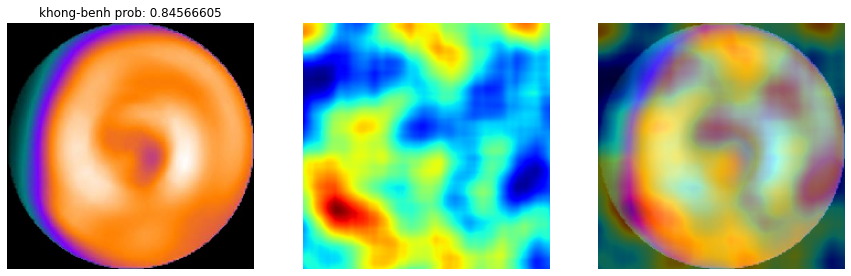

9


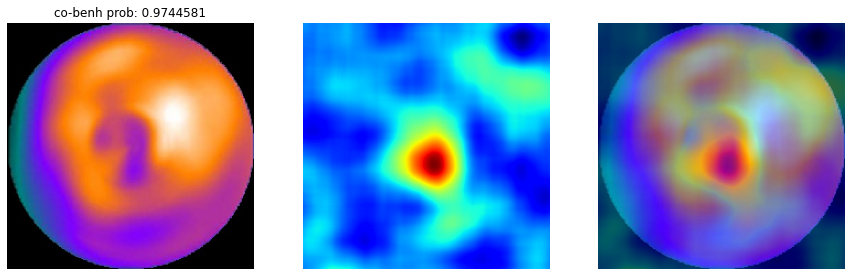

9


In [ ]:
run_rise(distilled_vgg16_mini)

**Student**

0


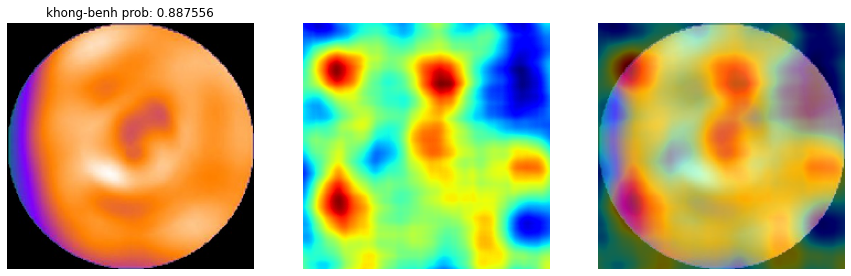

1


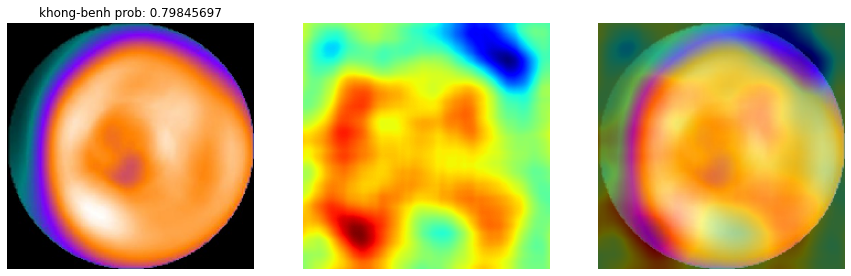

2


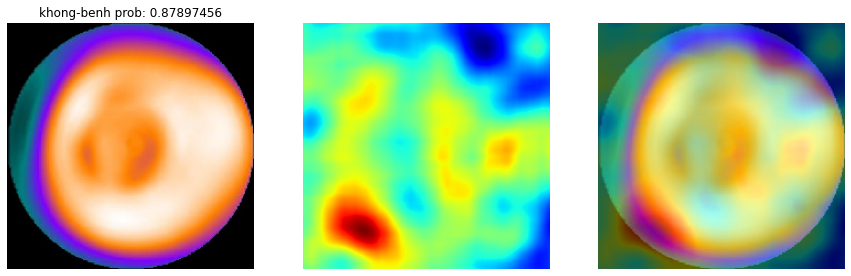

3


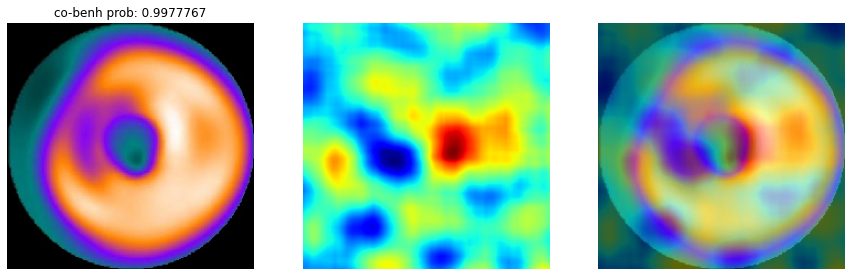

3
3
3


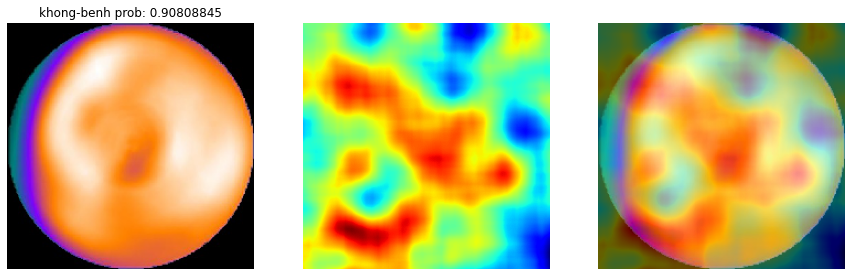

4


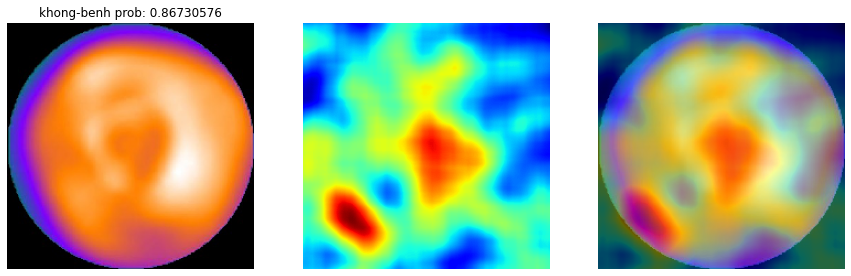

5
5


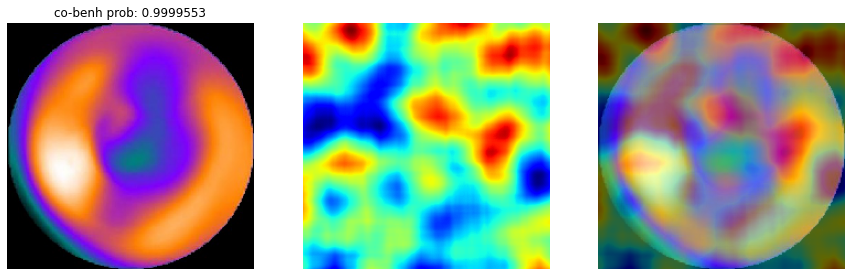

5


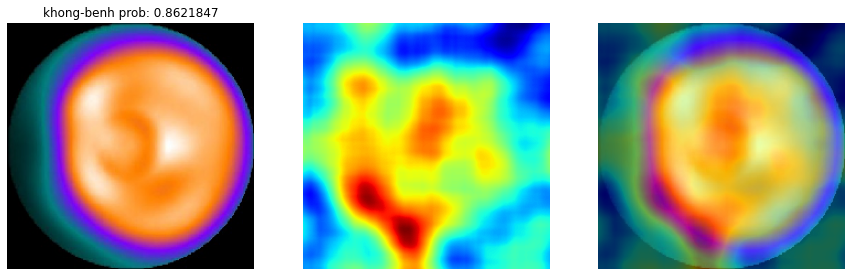

6


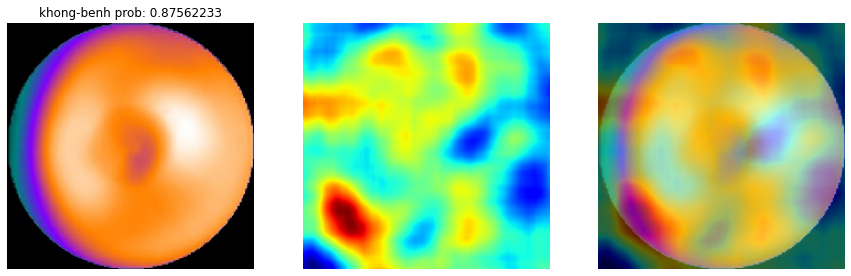

7


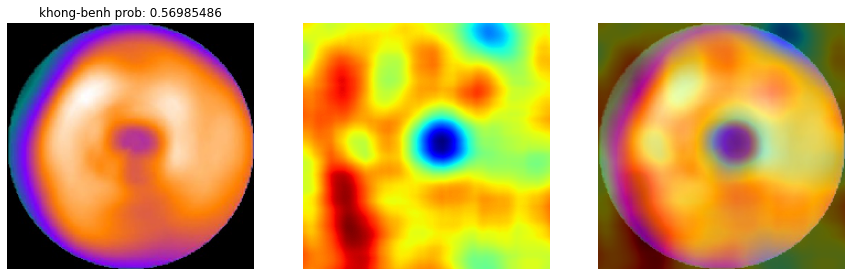

8


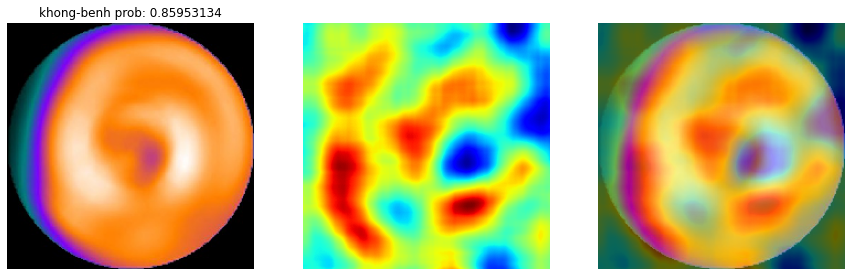

9


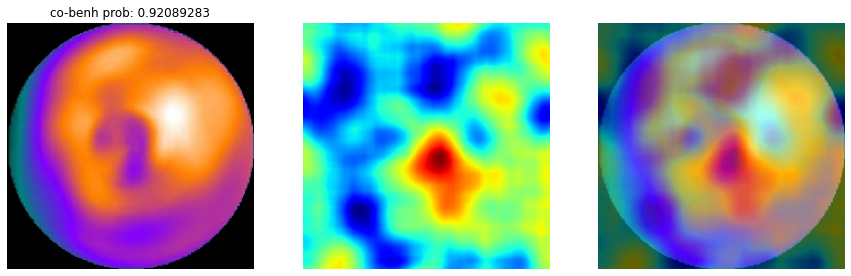

9


In [ ]:
run_rise(student_vgg16_mini)

**GradCam**

**Distilled**

0


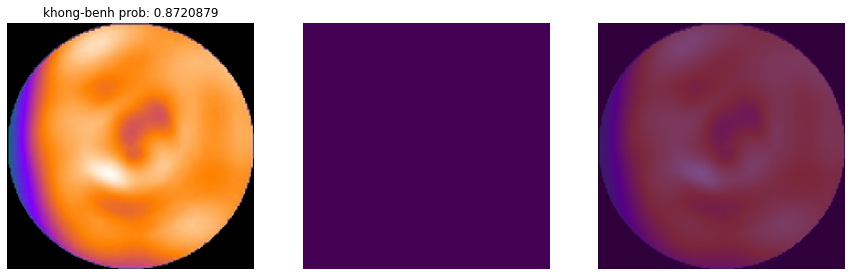

1


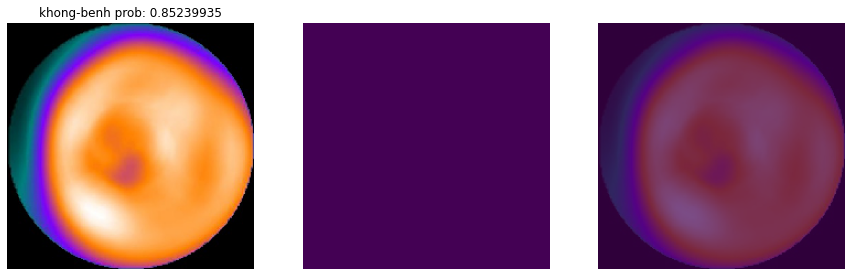

2


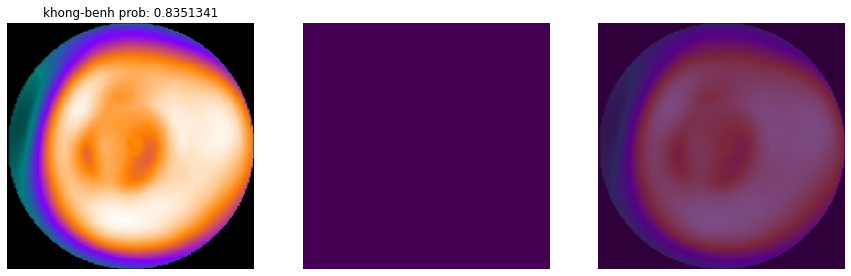

3


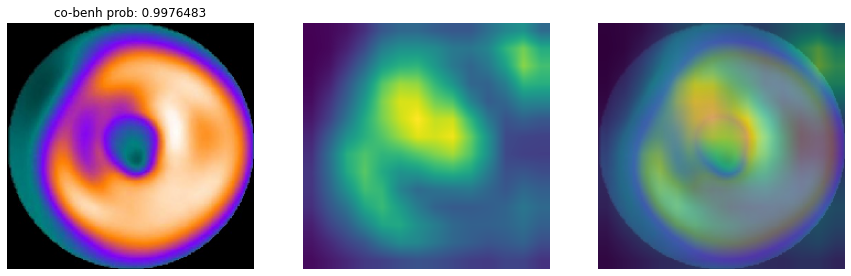

3
3
3


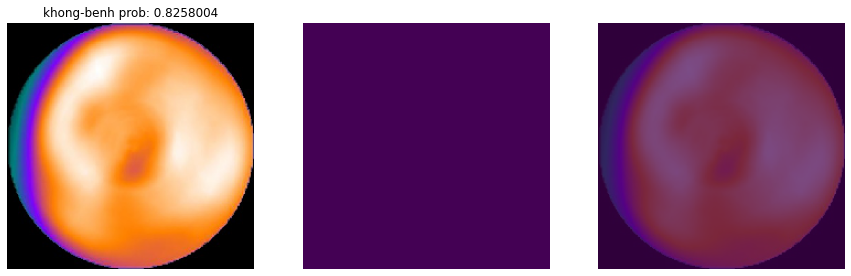

4


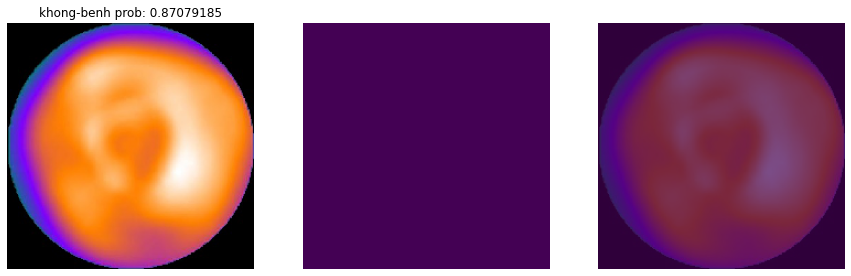

5
5


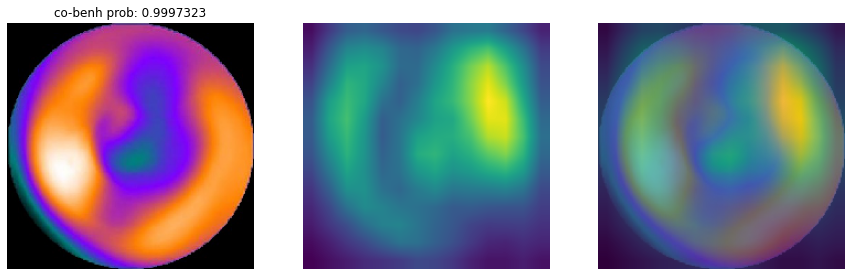

5


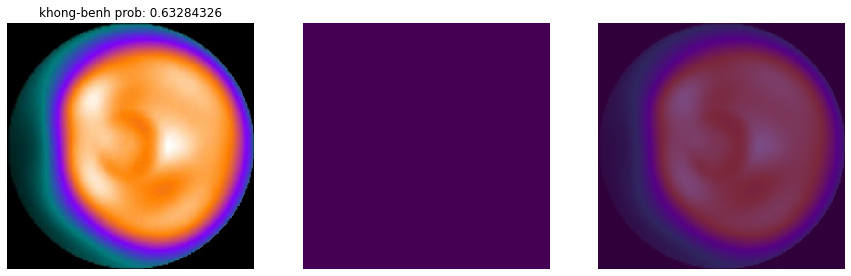

6


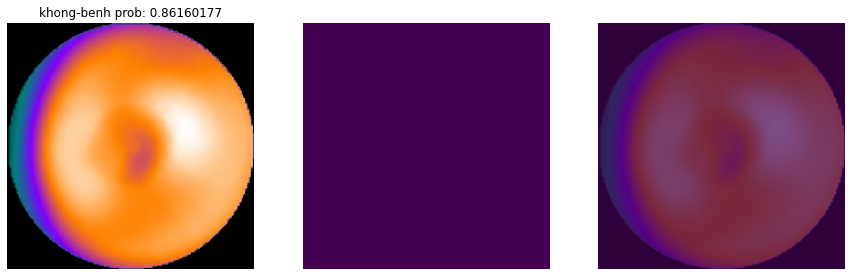

7


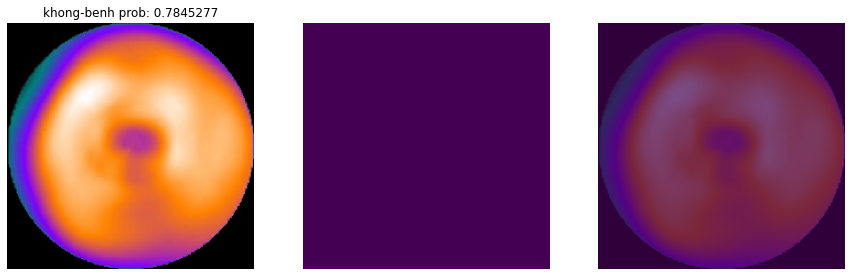

8


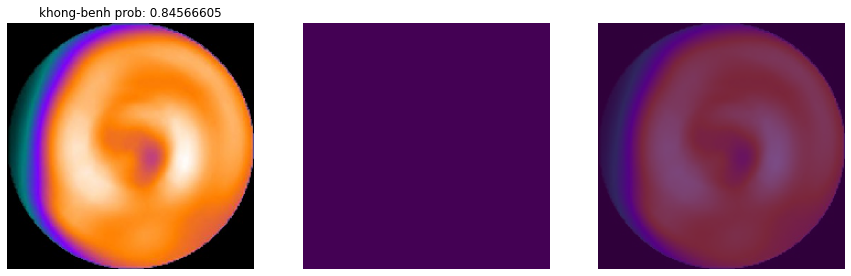

9


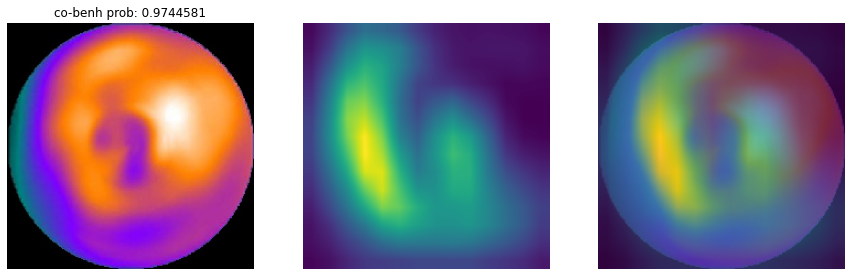

9


In [ ]:
runGrad(distilled_vgg16_mini,'block5_conv3')

**Student**

0


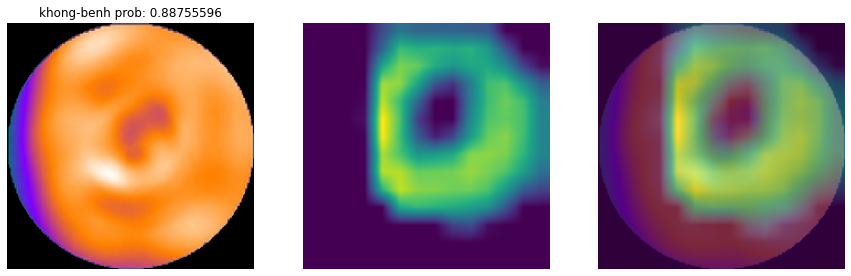

1


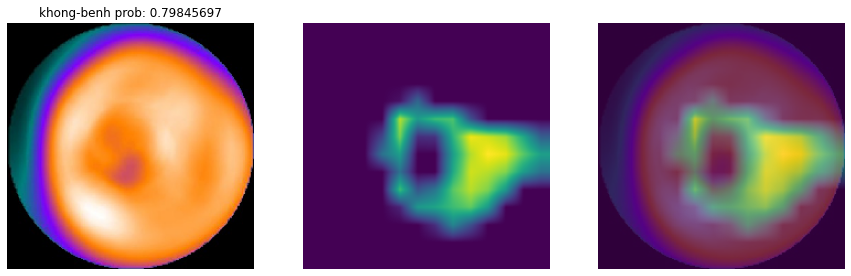

2


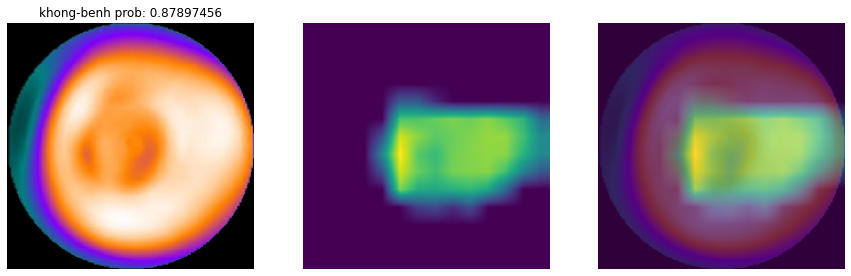

3


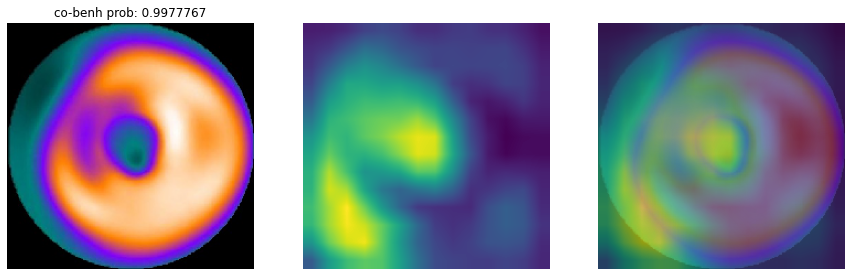

3
3
3


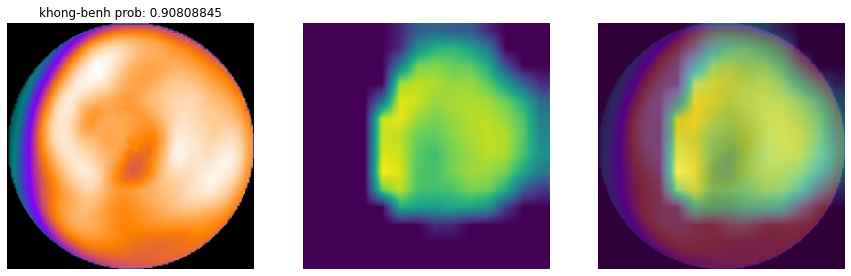

4


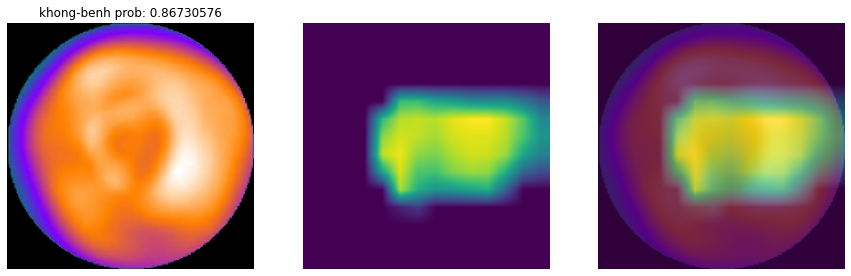

5
5


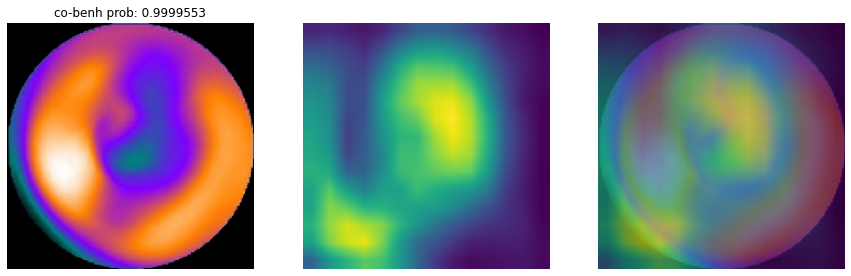

5


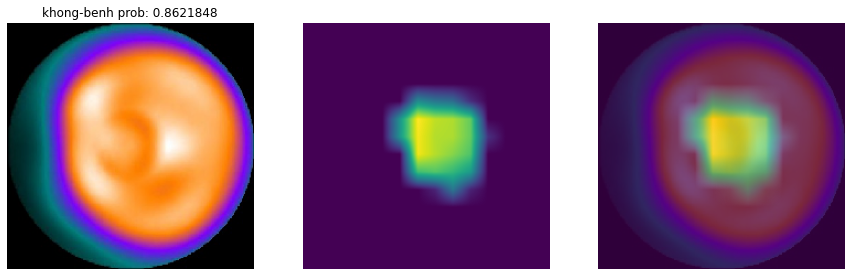

6


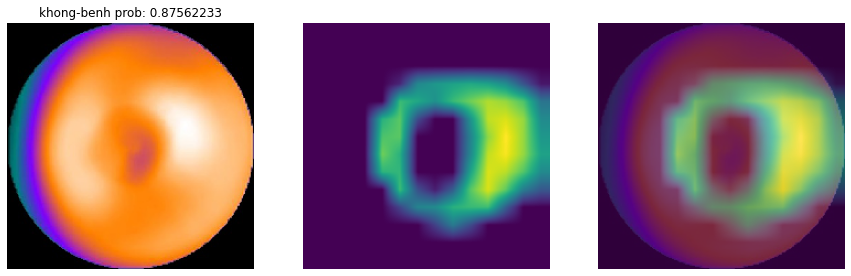

7


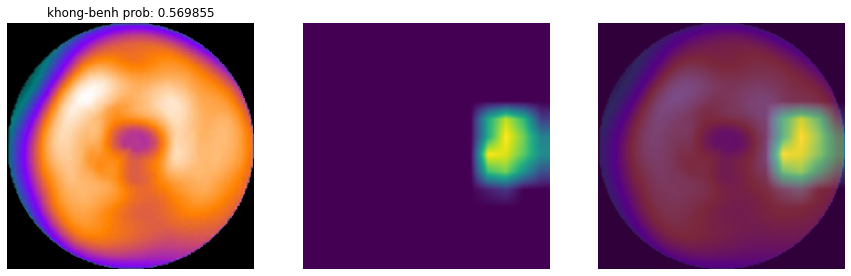

8


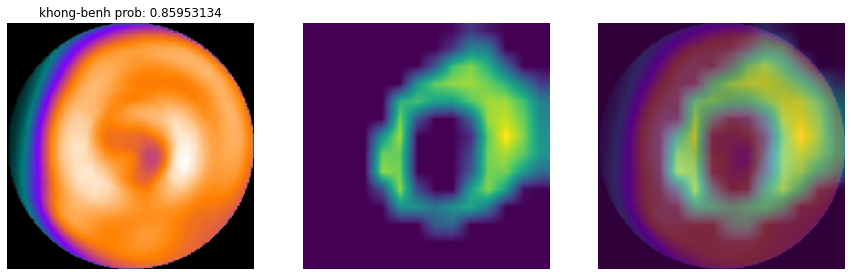

9


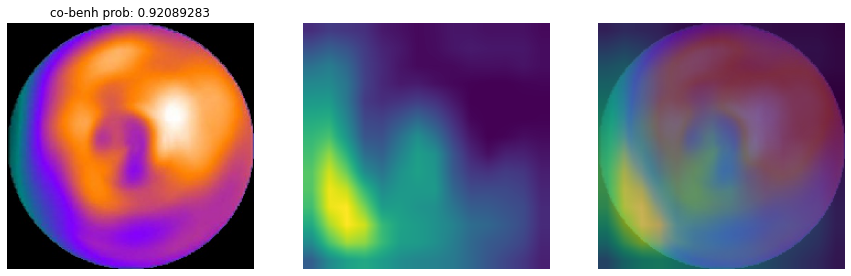

9


In [ ]:
runGrad(student_vgg16_mini,'block5_conv3')

**LIME**

**Distilled**

0


  0%|          | 0/1000 [00:00<?, ?it/s]

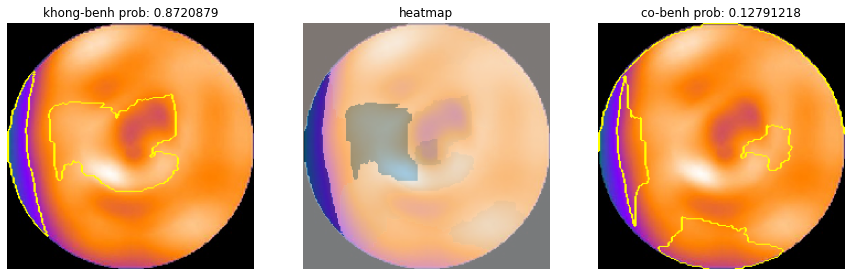

1


  0%|          | 0/1000 [00:00<?, ?it/s]

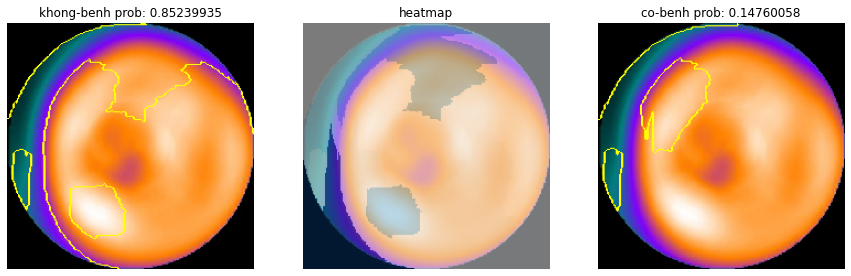

2


  0%|          | 0/1000 [00:00<?, ?it/s]

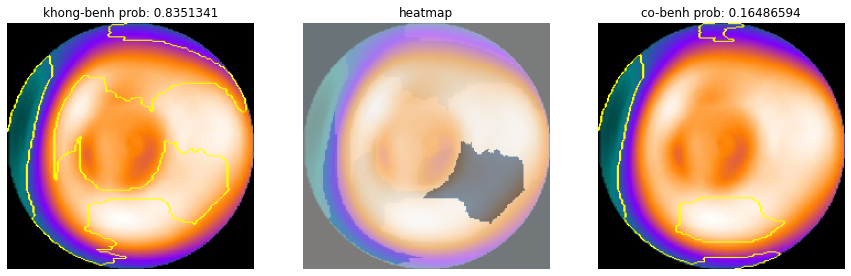

3


  0%|          | 0/1000 [00:00<?, ?it/s]

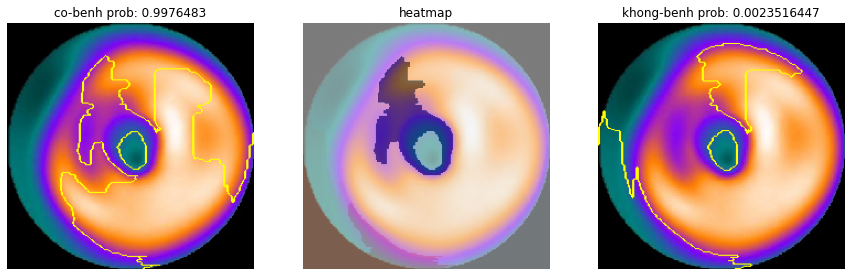

3
3
3


  0%|          | 0/1000 [00:00<?, ?it/s]

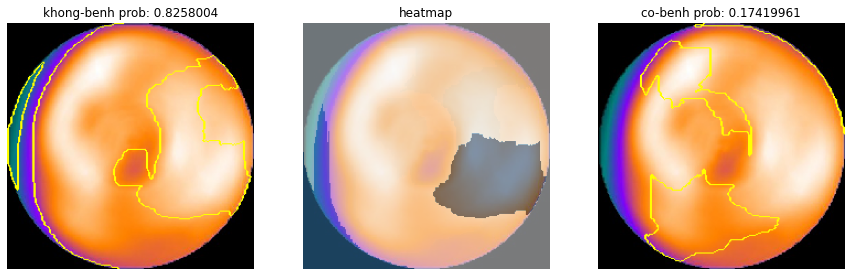

4


  0%|          | 0/1000 [00:00<?, ?it/s]

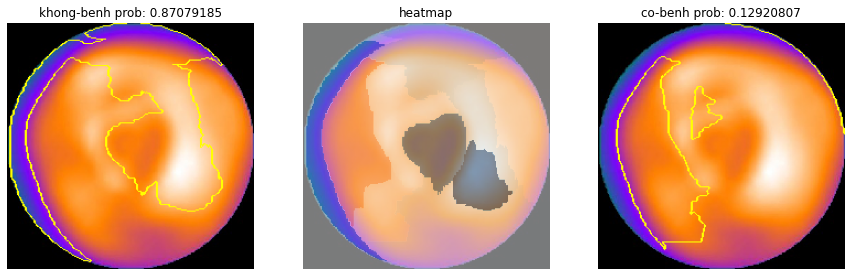

5
5


  0%|          | 0/1000 [00:00<?, ?it/s]

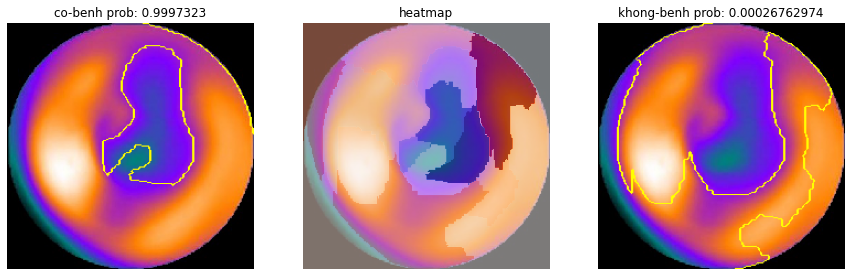

5


  0%|          | 0/1000 [00:00<?, ?it/s]

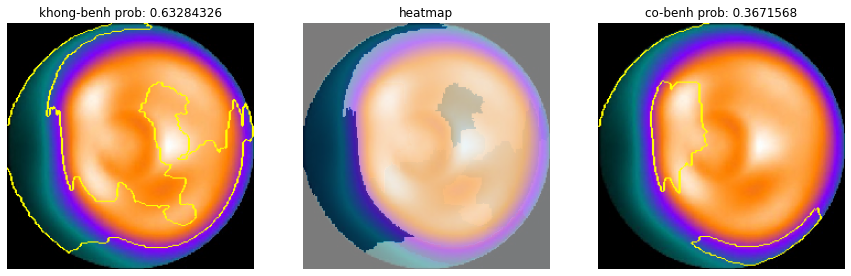

6


  0%|          | 0/1000 [00:00<?, ?it/s]

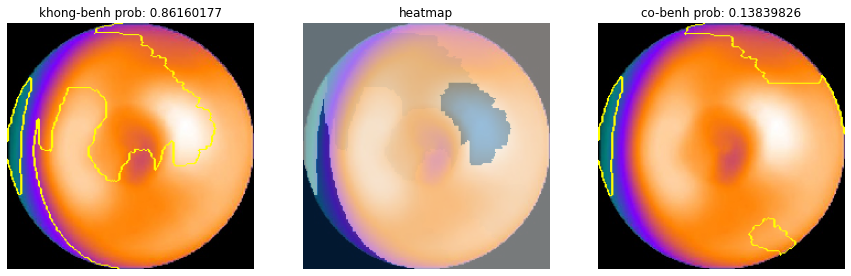

7


  0%|          | 0/1000 [00:00<?, ?it/s]

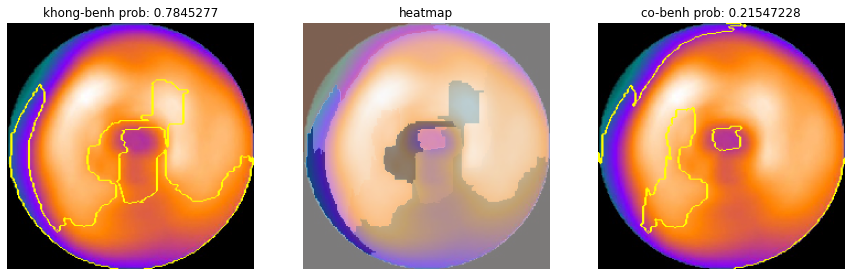

8


  0%|          | 0/1000 [00:00<?, ?it/s]

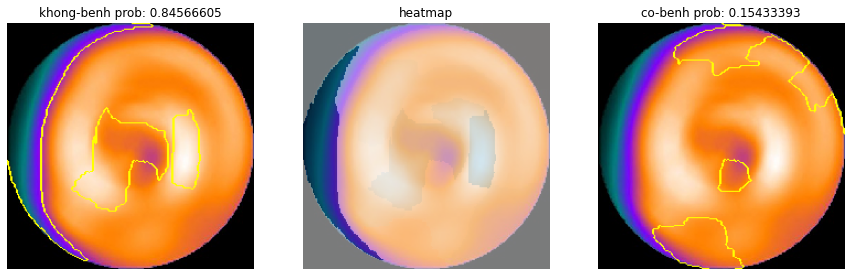

9


  0%|          | 0/1000 [00:00<?, ?it/s]

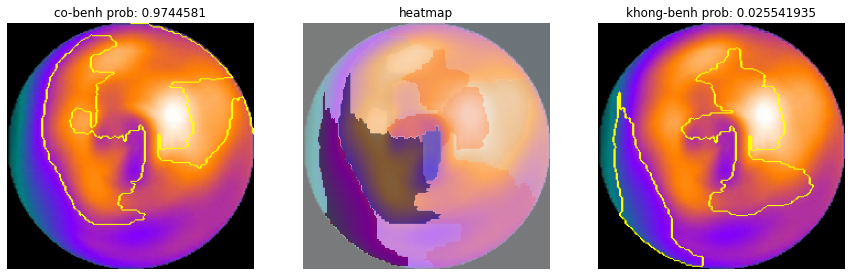

9


In [ ]:
runLime(distilled_vgg16_mini)

**Student**

0


  0%|          | 0/1000 [00:00<?, ?it/s]

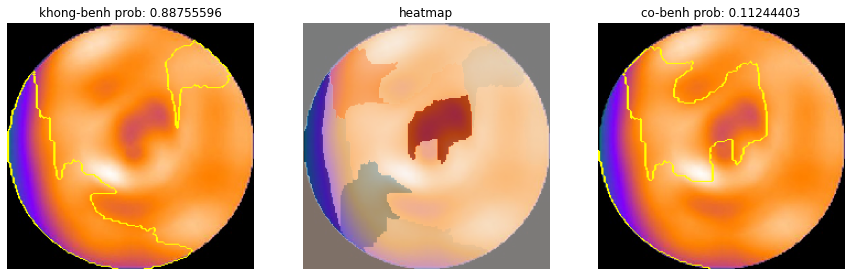

1


  0%|          | 0/1000 [00:00<?, ?it/s]

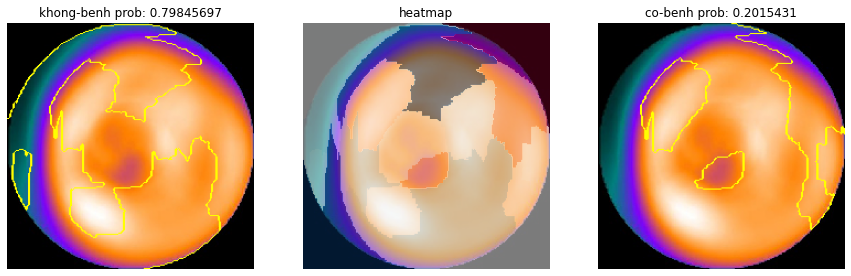

2


  0%|          | 0/1000 [00:00<?, ?it/s]

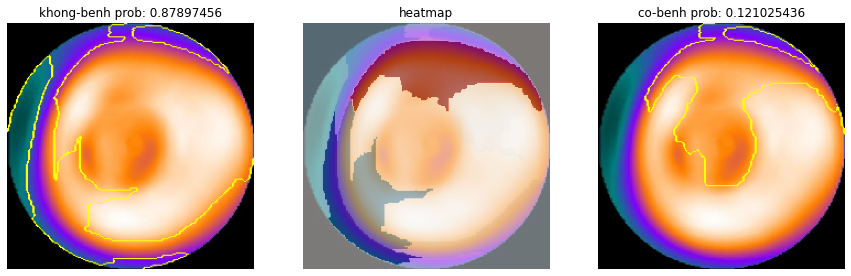

3


  0%|          | 0/1000 [00:00<?, ?it/s]

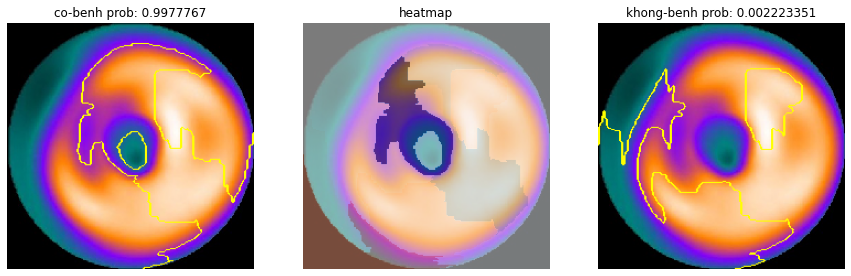

3
3
3


  0%|          | 0/1000 [00:00<?, ?it/s]

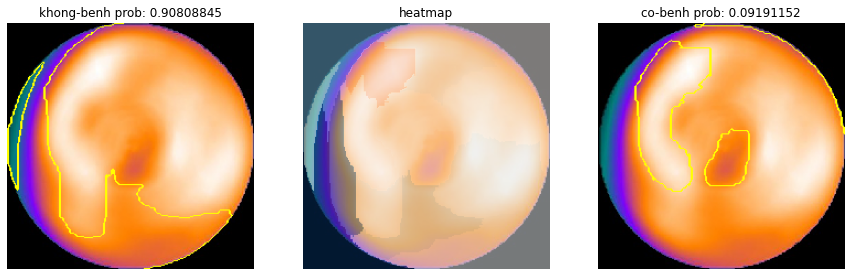

4


  0%|          | 0/1000 [00:00<?, ?it/s]

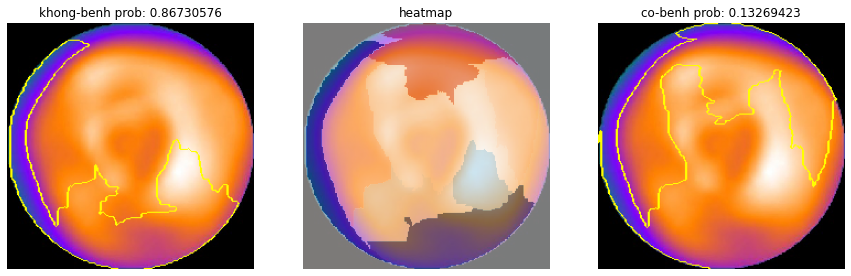

5
5


  0%|          | 0/1000 [00:00<?, ?it/s]

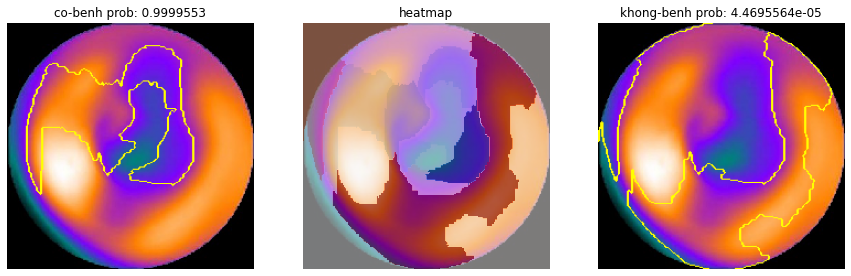

5


  0%|          | 0/1000 [00:00<?, ?it/s]

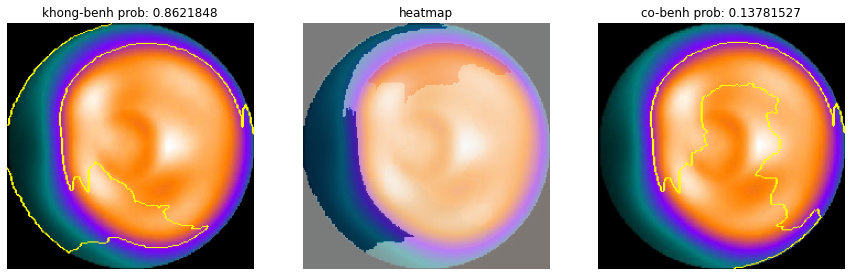

6


  0%|          | 0/1000 [00:00<?, ?it/s]

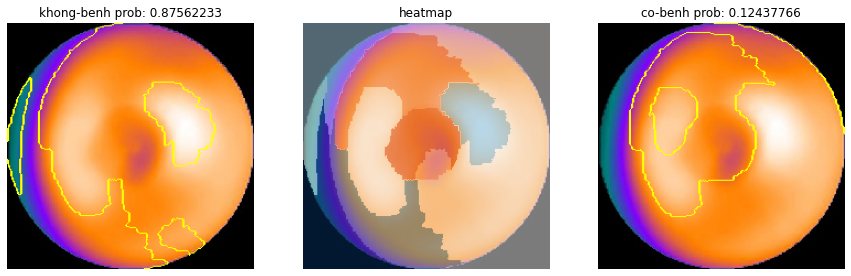

7


  0%|          | 0/1000 [00:00<?, ?it/s]

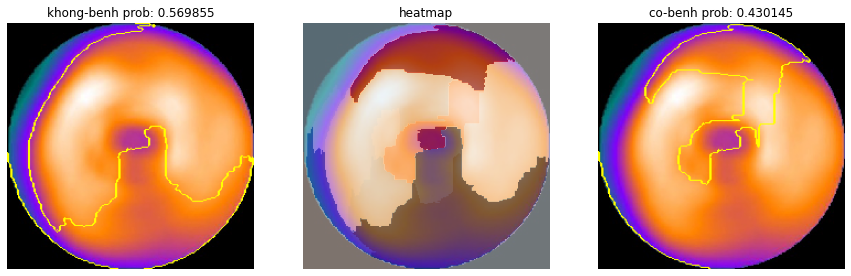

8


  0%|          | 0/1000 [00:00<?, ?it/s]

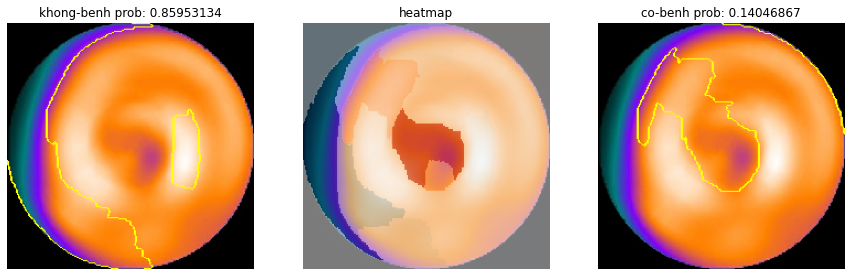

9


  0%|          | 0/1000 [00:00<?, ?it/s]

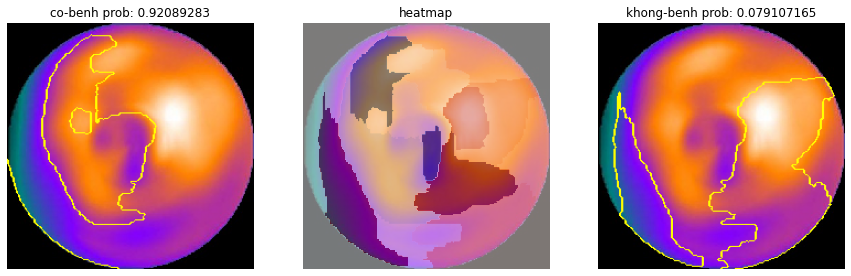

9


In [ ]:
runLime(student_vgg16_mini)

#Distillation MobileNetV2

In [ ]:
def mobile_net_v2():
    net = tf.keras.applications.MobileNetV2(include_top=False,input_shape=(224,224,3))

    # Dong bang cac layer
    for layer in net.layers:
        layer.trainable = False

    flat1 = keras.layers.GlobalAveragePooling2D()(net.layers[-1].output)
    class1 = Dense(256, activation='relu')(flat1)
    class2 = Dropout(0.2)(class1)
    output = Dense(2, activation='softmax')(class2)
    # define new model
    model = Model(inputs=net.inputs, outputs=output)
    model.compile(loss='sparse_categorical_crossentropy', optimizer='adam', metrics=[keras.metrics.SparseCategoricalAccuracy()])
    return model

In [ ]:
mobile_net_v2= mobile_net_v2()

**Distillation**

In [ ]:
distiller = Distiller(student=mobile_net_v2, teacher=teacher)

distiller.compile(
    optimizer=keras.optimizers.Adam(),
    metrics=[keras.metrics.SparseCategoricalAccuracy()],
    student_loss_fn=keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=keras.losses.KLDivergence(),
    alpha=0.1,
    temperature=10,
)
# Distill teacher to student
max = 0.0
for i in range(100):
  history=distiller.fit(X_train, y_train,
                                epochs=1,validation_data=(X_test,y_test))
  eval = distiller.evaluate(X_test,y_test)
  if(eval[0]>max):
    max = eval[0]
    print("save weights"+ str(eval[0]))
    distiller.save_weights('./drive/MyDrive/Explainable/Distilltion/distiller_mobile_net_v2.hdf5')
distiller.built = True
distiller.load_weights('./drive/MyDrive/Explainable/Distilltion/distiller_mobile_net_v2.hdf5')
distiller.student.save('./drive/MyDrive/Explainable/Distilltion/distilled_mobile_net_v2.h5')

In [ ]:
distiller.student.summary()

In [ ]:
distilled_mobilenet_v2 = keras.models.load_model(filepath='./drive/MyDrive/Explainable/Distilltion/distilled_mobile_net_v2.h5')
distilled_mobilenet_v2.evaluate(X_test,y_test)
evaluate_all(distilled_mobilenet_v2)

2/2 [==============================] - 2s 348ms/step - loss: 0.1653 - sparse_categorical_accuracy: 0.9091
Overall accuracy of Neural Network model: 0.09090909090909091
[0. 0. 0. 1.]
AUC_Glob:  0.9047619047619048
(44, 2)
(44,)
(44,)
Accuracy: 0.909091
Precision: 0.925926
Recall: 0.904762
F1 score: 0.907368
Specificity: 0.809524


In [ ]:
distilled_mobilenet_v2.predict(X_test)

In [ ]:
flops = get_flops(distilled_mobilenet_v2, batch_size=1)
print(f"FLOPS: {flops / 10 ** 9:.03} G")

FLOPS: 0.613 G


In [ ]:
predict(distilled_mobilenet_v2)

--- 0.09409236907958984 seconds ---


**Student**

In [ ]:
student = mobile_net_v2()
filepath="./drive/MyDrive/Explainable/Distilltion/student_mobile_net_v2.hdf5"
checkpoint = ModelCheckpoint(filepath, monitor='val_sparse_categorical_accuracy', verbose=1, save_best_only=True, mode='max')
callbacks_list = [checkpoint]
# Train and evaluate student trained from scratch.
student.fit(X_train, y_train,
                               epochs=100,
                               validation_data=(X_test,y_test),
                               callbacks=callbacks_list)
student.built = True
student.load_weights('./drive/MyDrive/Explainable/Distilltion/student_mobile_net_v2.hdf5')
student.save('./drive/MyDrive/Explainable/Distilltion/student_mobile_net_v2.h5')

In [ ]:
student.summary()

In [ ]:
student_mobilenet_v2 = keras.models.load_model(filepath='./drive/MyDrive/Explainable/Distilltion/student_mobile_net_v2.h5')
student_mobilenet_v2.evaluate(X_test,y_test)
evaluate_all(student_mobilenet_v2)

2/2 [==============================] - 2s 348ms/step - loss: 0.3861 - sparse_categorical_accuracy: 0.8636
Overall accuracy of Neural Network model: 0.13636363636363635
[0.         0.         0.         0.2173913  0.2173913  0.34782609
 0.34782609 0.47826087 0.47826087 0.56521739 0.56521739 1.        ]
AUC_Glob:  0.8571428571428572
(44, 2)
(44,)
(44,)
Accuracy: 0.863636
Precision: 0.896552
Recall: 0.857143
F1 score: 0.858974
Specificity: 0.714286


In [ ]:
student_mobilenet_v2.summary()

Model: "model_20"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_21 (InputLayer)          [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 112, 112, 32  864         ['input_21[0][0]']               
                                )                                                                 
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 112, 112, 32  128         ['Conv1[0][0]']                  
                                )                                                          

In [ ]:
flops = get_flops(student_mobilenet_v2, batch_size=1)
print(f"FLOPS: {flops / 10 ** 9:.03} G")

FLOPS: 0.613 G


In [ ]:
predict(student_mobilenet_v2)

--- 0.09716343879699707 seconds ---


**RISE**

**Distilled**

0


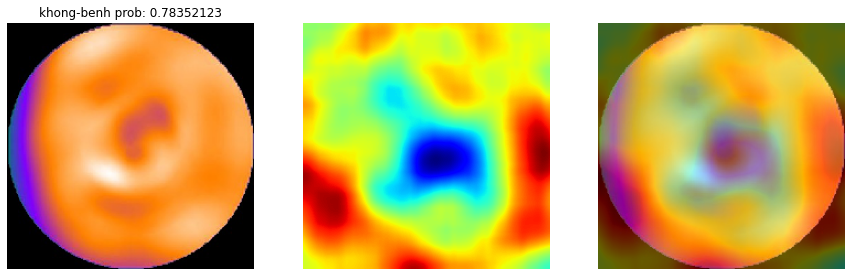

1


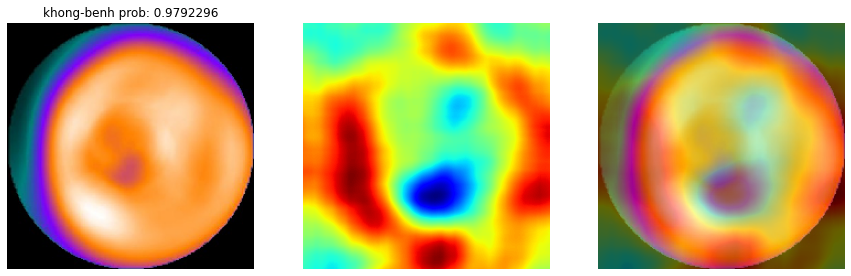

2


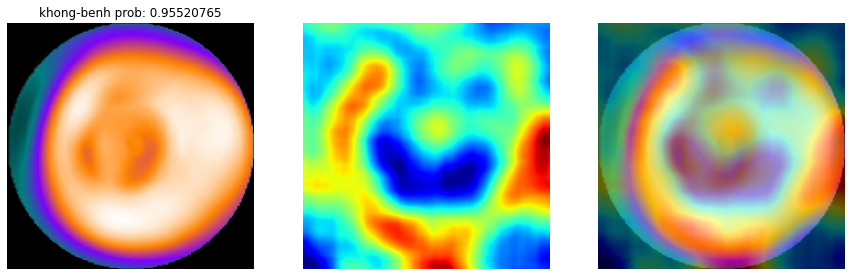

3


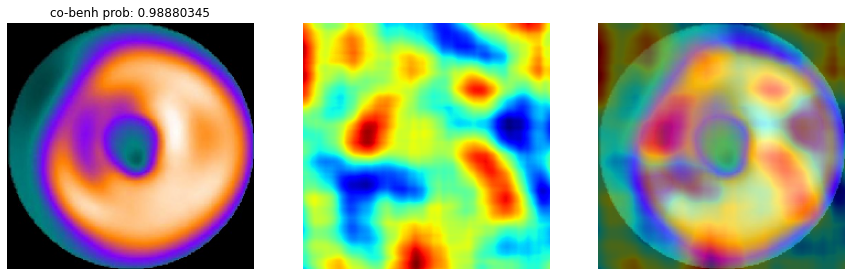

3
3
3


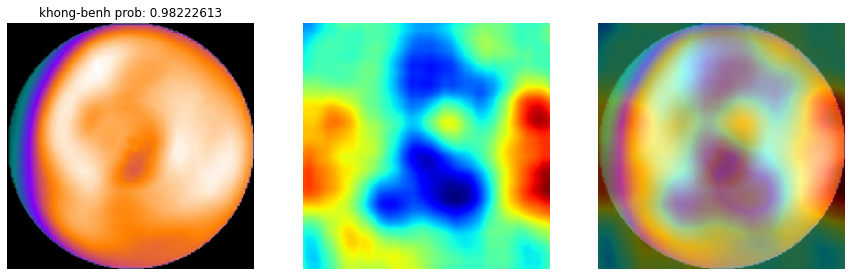

4


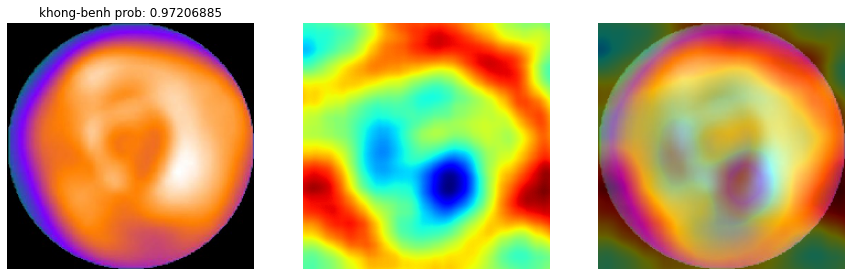

5


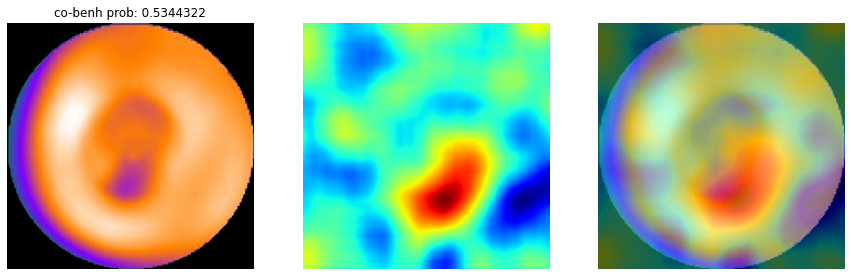

5


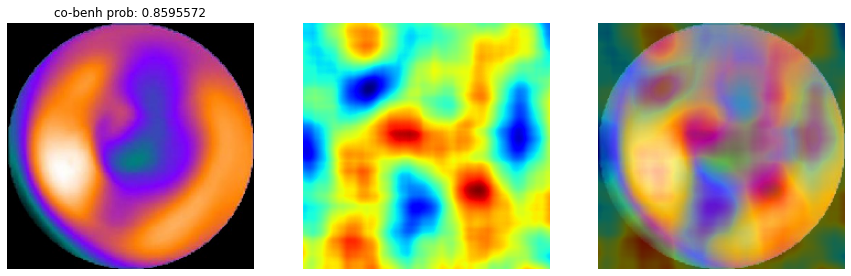

5


In [ ]:
run_rise(distilled_mobilenet_v2)

**Student**

0


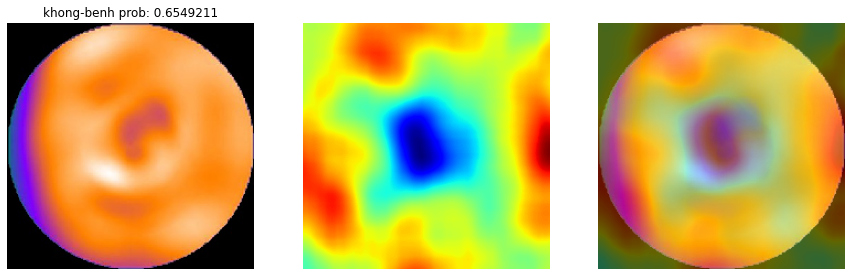

1


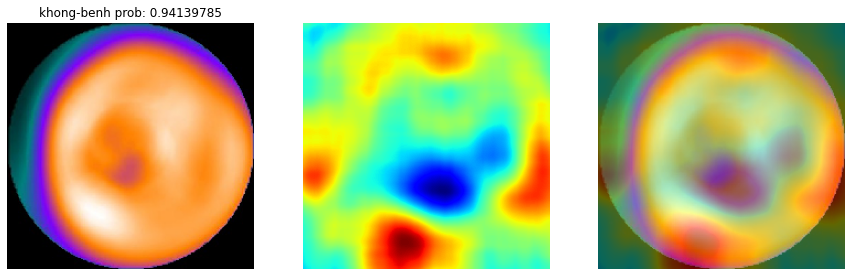

2


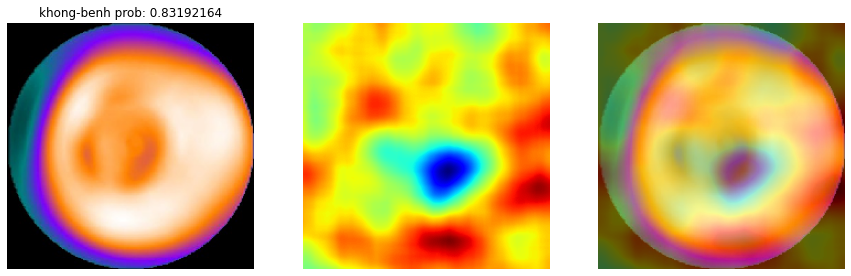

3


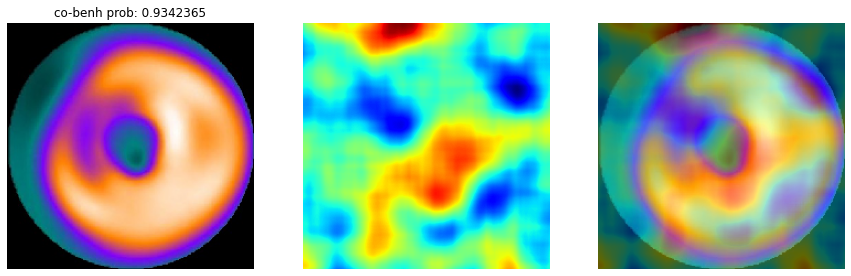

3
3
3


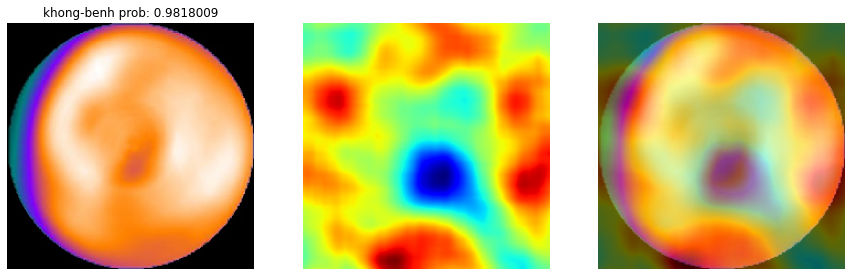

4


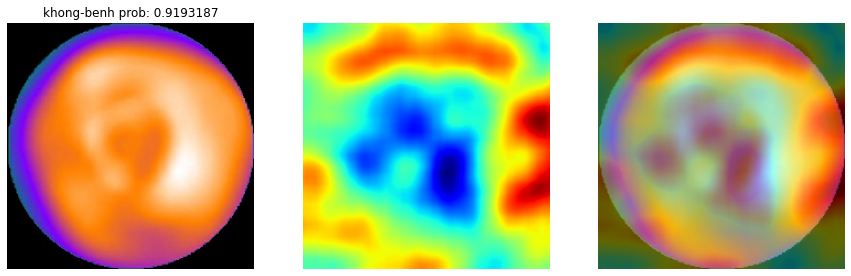

5
5


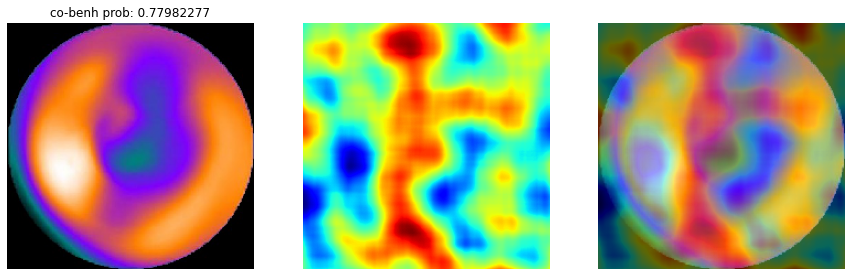

5


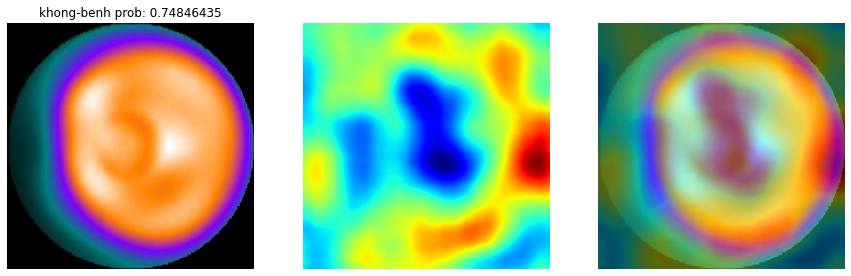

6


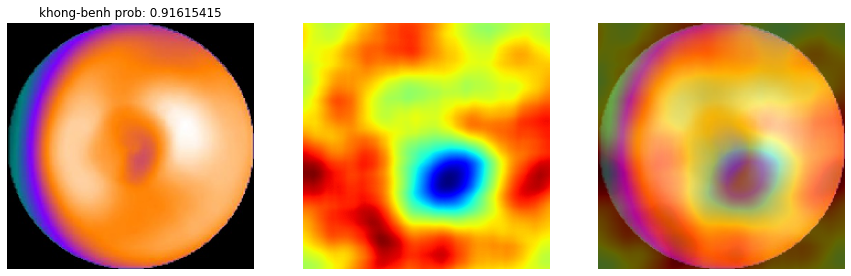

7


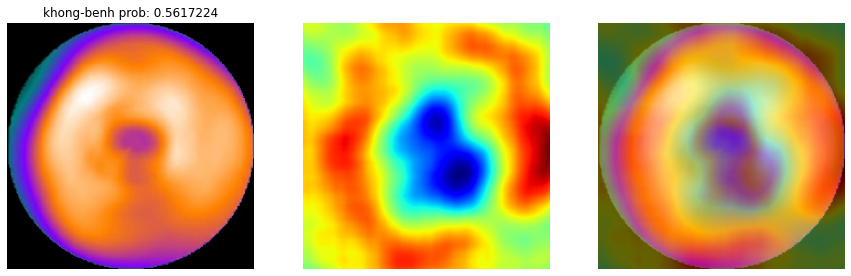

8


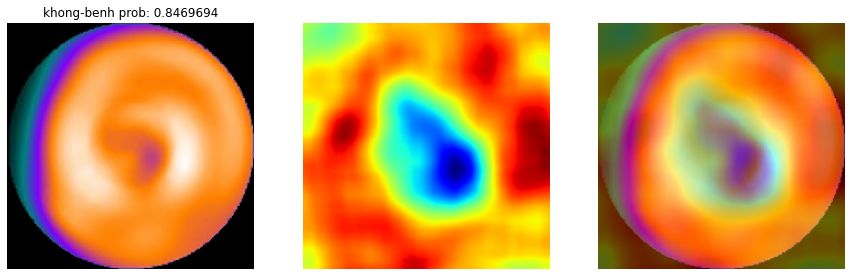

9


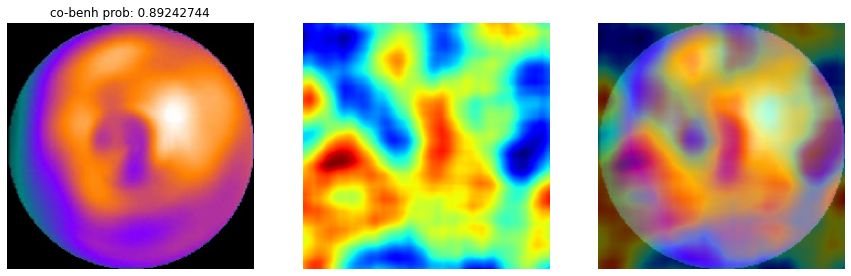

9


In [ ]:
run_rise(student_mobilenet_v2)

**LIME**

**Distiller**

0


  0%|          | 0/1000 [00:00<?, ?it/s]

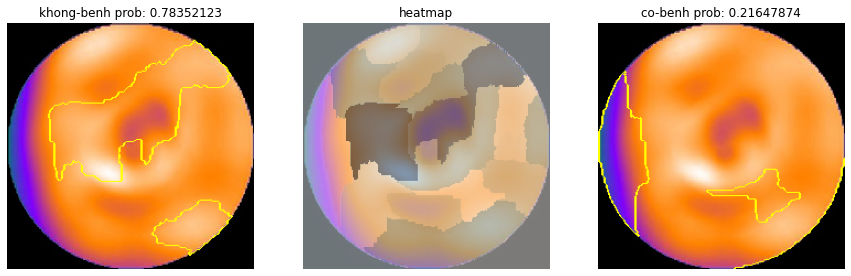

1


  0%|          | 0/1000 [00:00<?, ?it/s]

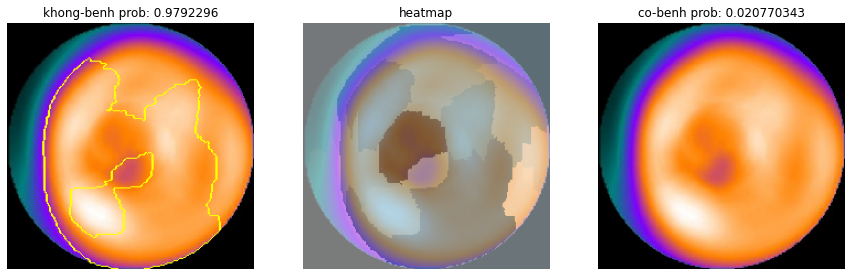

2


  0%|          | 0/1000 [00:00<?, ?it/s]

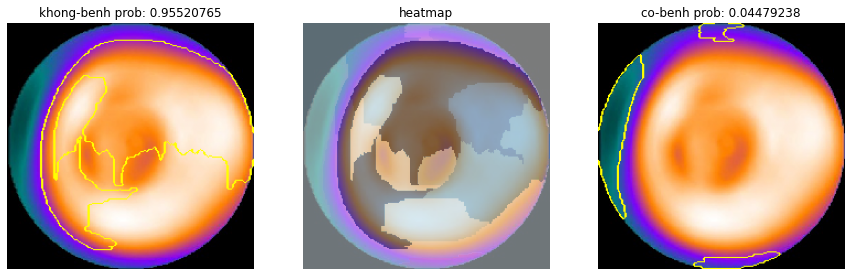

3


  0%|          | 0/1000 [00:00<?, ?it/s]

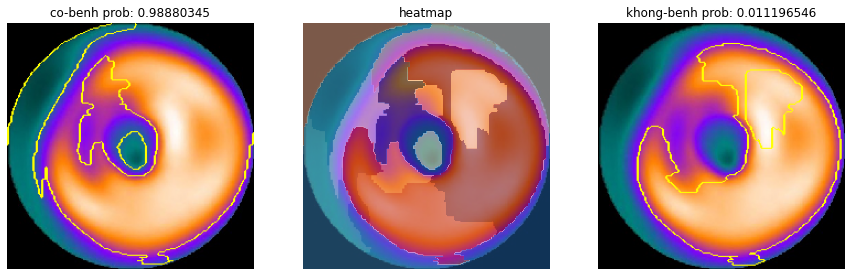

3
3
3


  0%|          | 0/1000 [00:00<?, ?it/s]

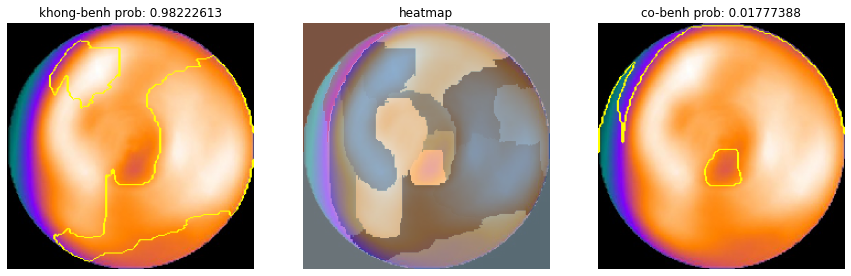

4


  0%|          | 0/1000 [00:00<?, ?it/s]

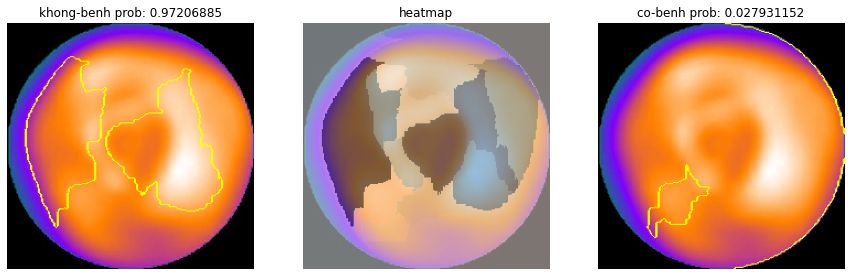

5


  0%|          | 0/1000 [00:00<?, ?it/s]

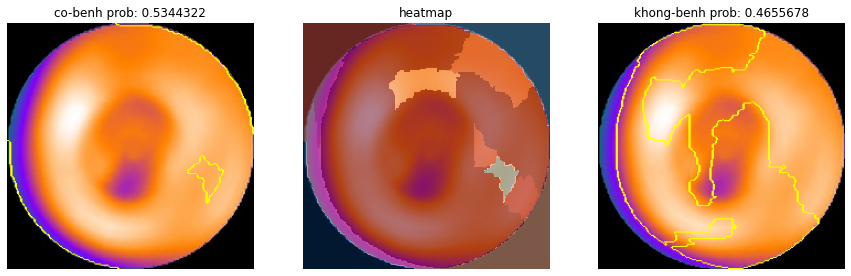

5


  0%|          | 0/1000 [00:00<?, ?it/s]

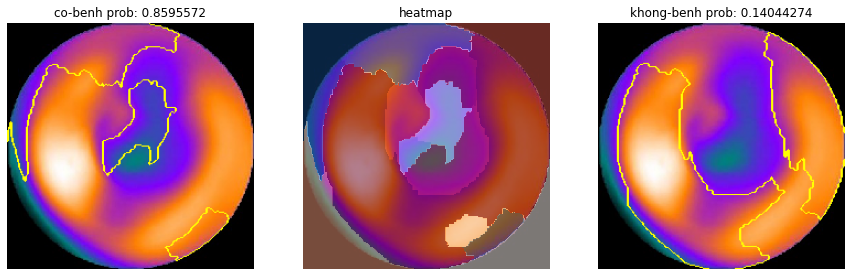

5


In [ ]:
runLime(distilled_mobilenet_v2)

**Student**

0


  0%|          | 0/1000 [00:00<?, ?it/s]

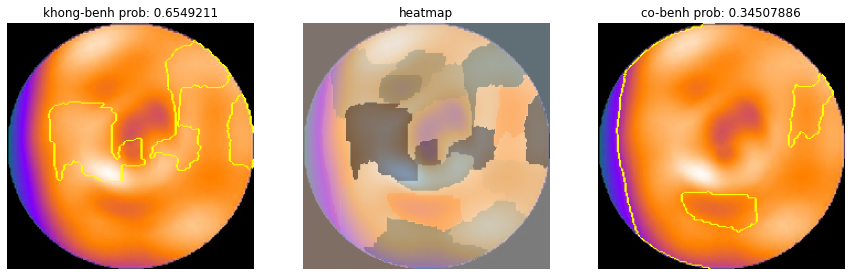

1


  0%|          | 0/1000 [00:00<?, ?it/s]

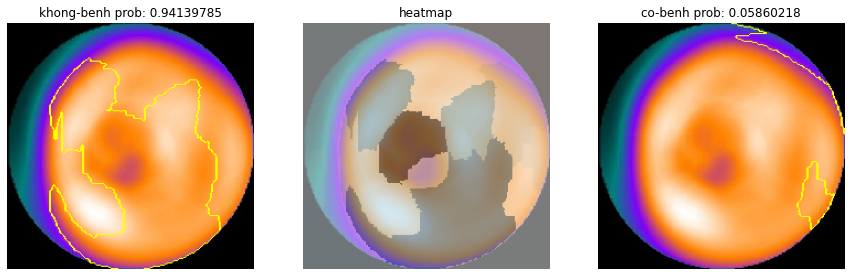

2


  0%|          | 0/1000 [00:00<?, ?it/s]

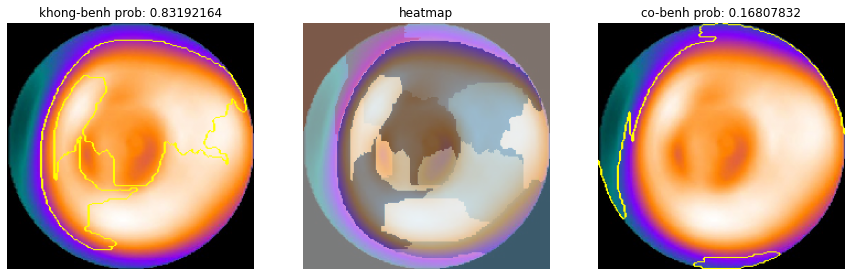

3


  0%|          | 0/1000 [00:00<?, ?it/s]

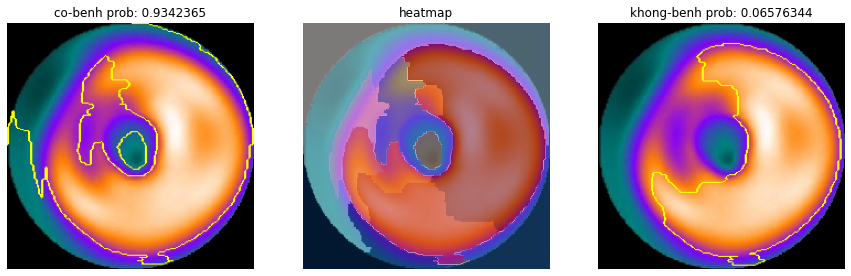

3
3
3


  0%|          | 0/1000 [00:00<?, ?it/s]

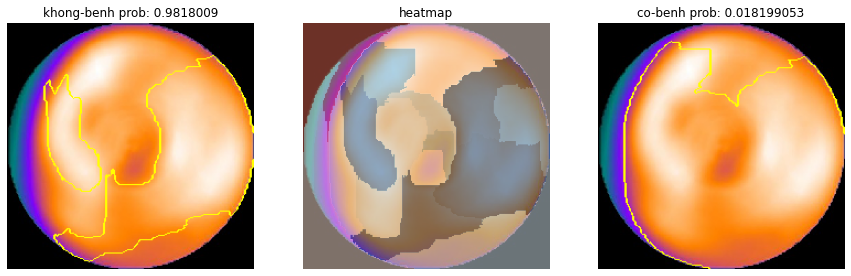

4


  0%|          | 0/1000 [00:00<?, ?it/s]

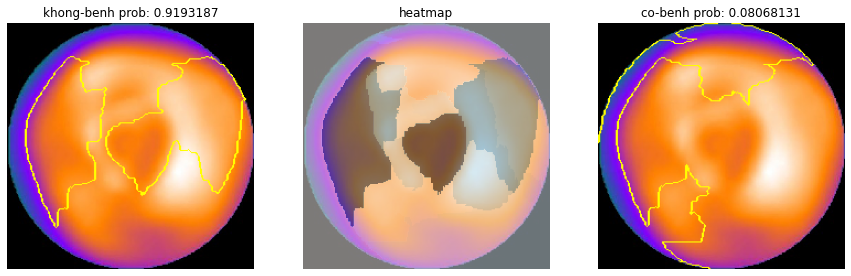

5
5


  0%|          | 0/1000 [00:00<?, ?it/s]

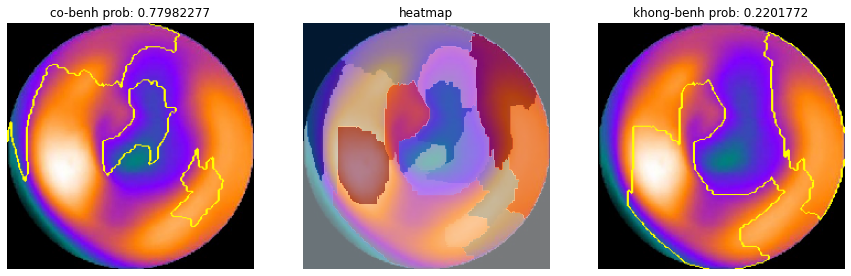

5


  0%|          | 0/1000 [00:00<?, ?it/s]

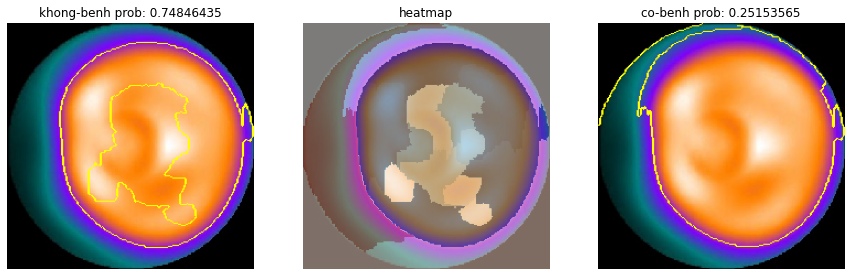

6


  0%|          | 0/1000 [00:00<?, ?it/s]

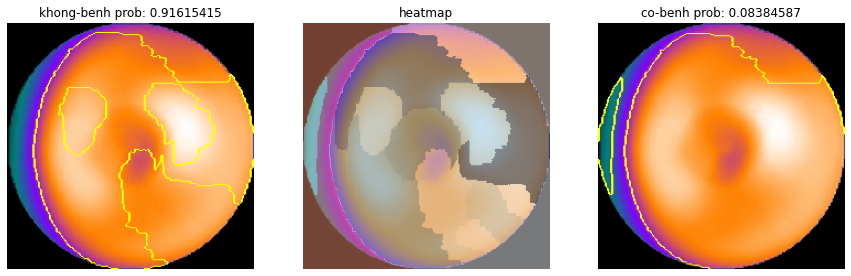

7


  0%|          | 0/1000 [00:00<?, ?it/s]

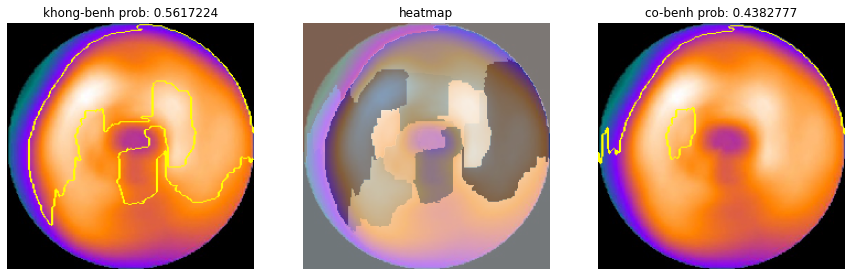

8


  0%|          | 0/1000 [00:00<?, ?it/s]

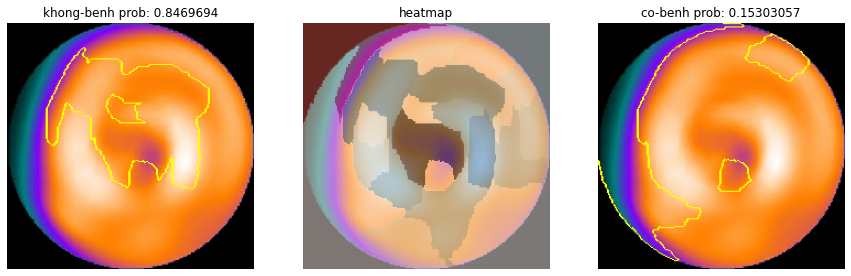

9


  0%|          | 0/1000 [00:00<?, ?it/s]

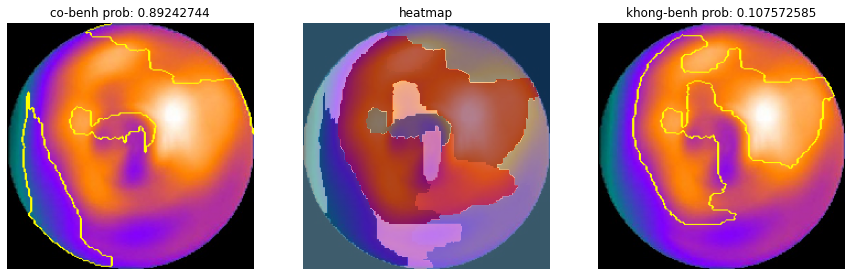

9


In [ ]:
runLime(student_mobilenet_v2)

Grad-Cam

**Distilled**

0


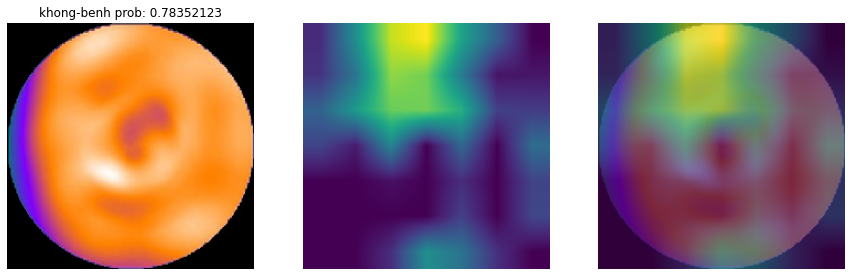

1


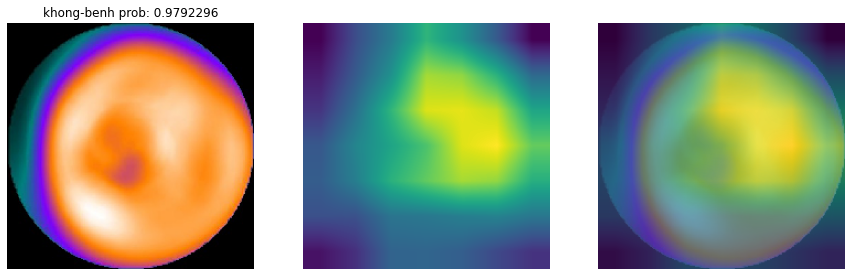

2


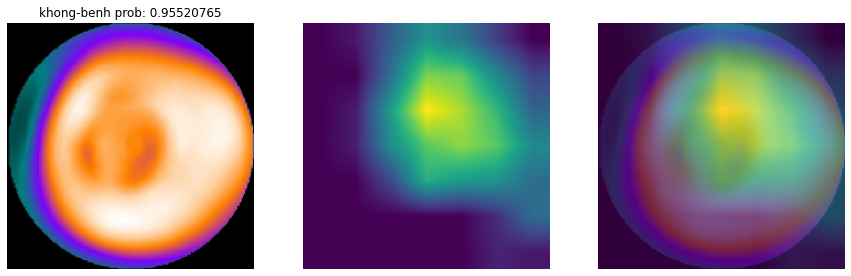

3


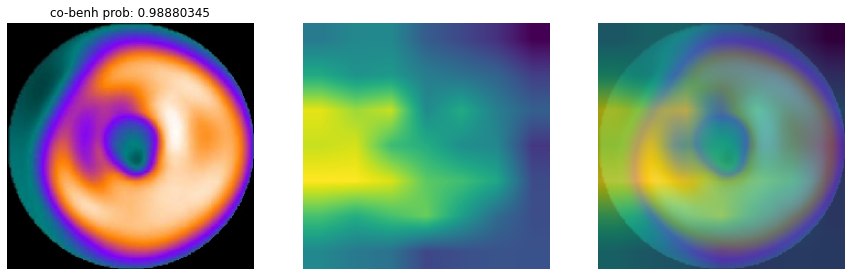

3
3
3


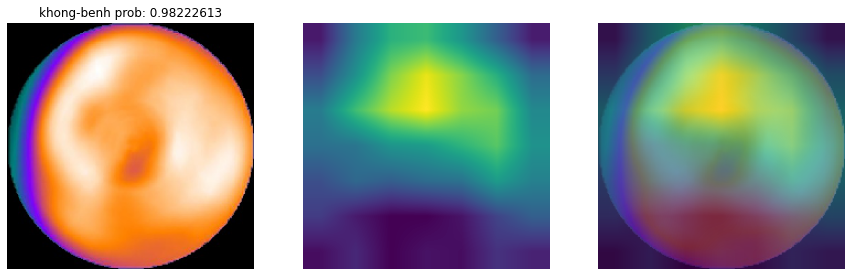

4


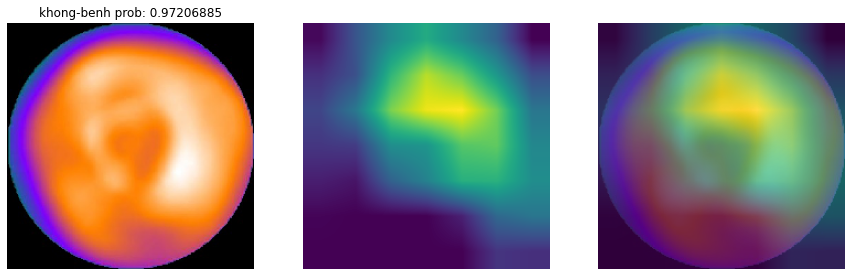

5


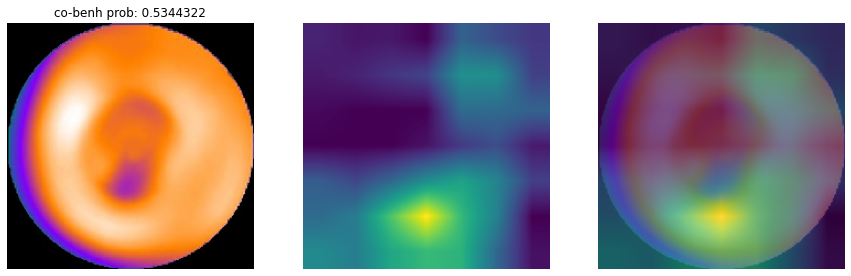

5


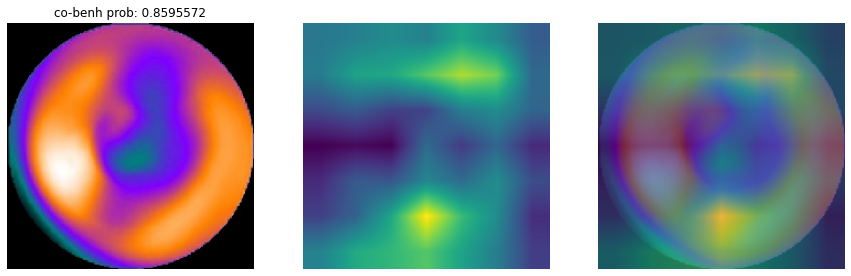

5


In [ ]:
runGrad(distilled_mobilenet_v2,'Conv_1')

**Student**

0


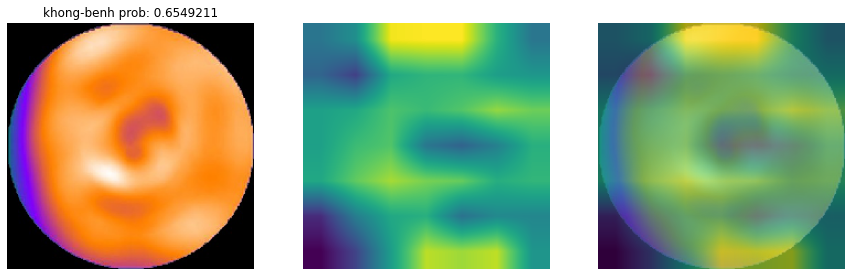

1


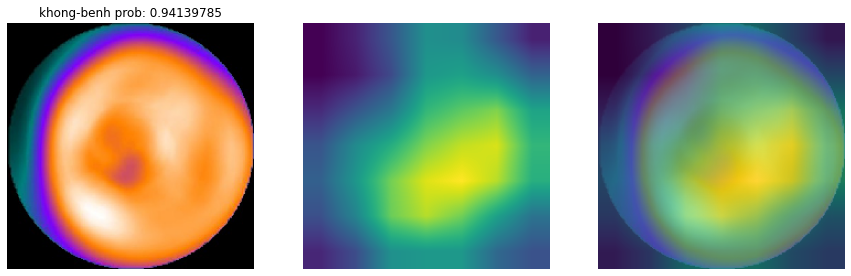

2


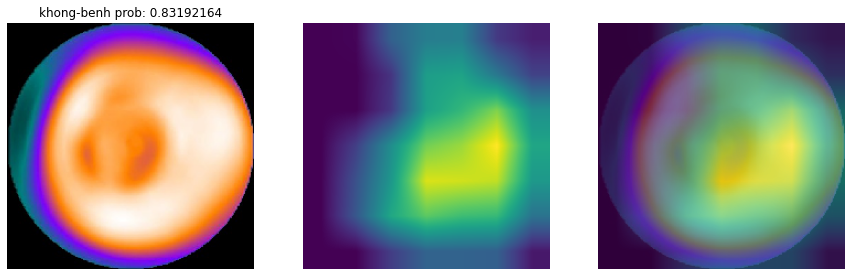

3


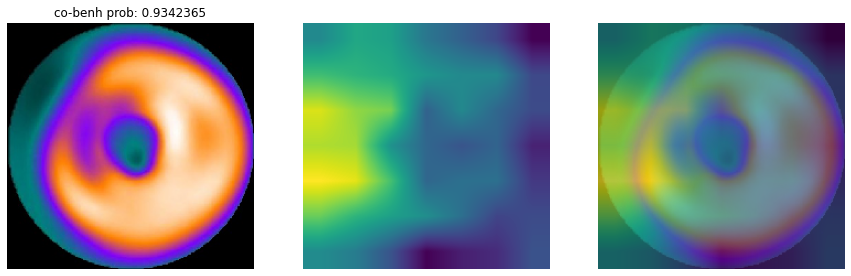

3
3
3


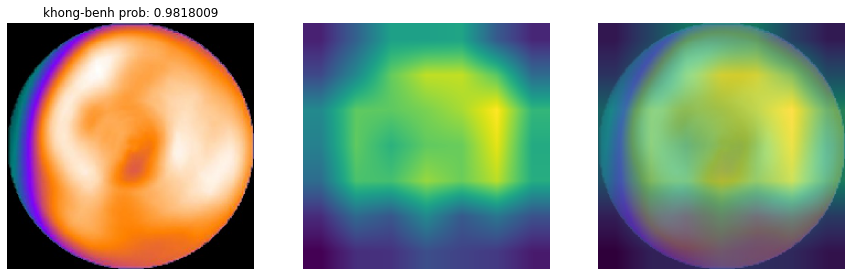

4


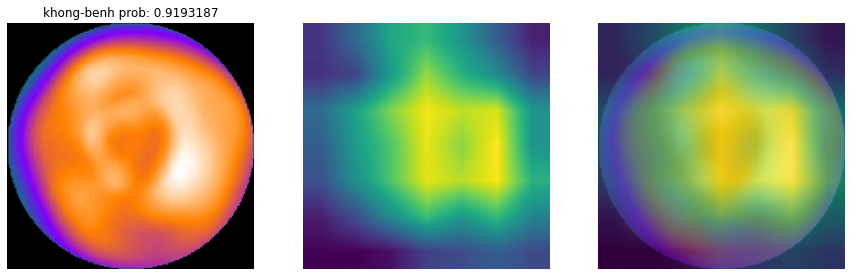

5
5


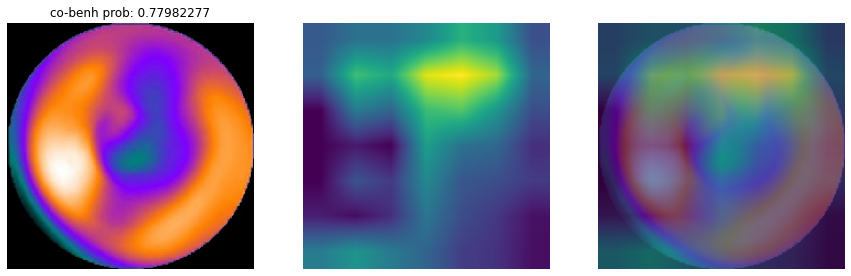

5


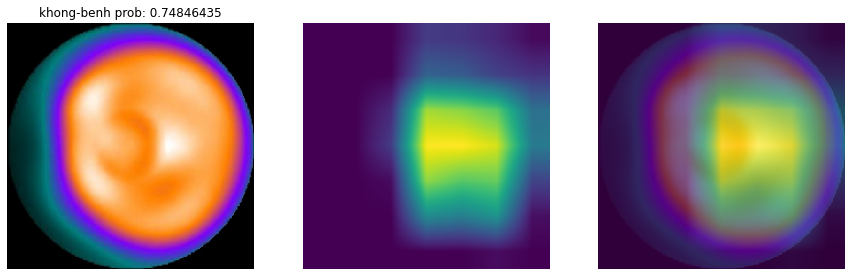

6


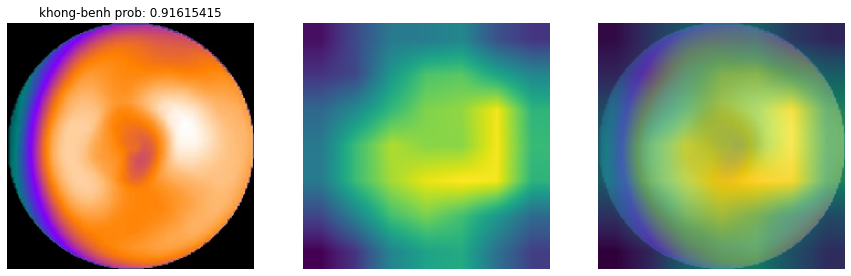

7


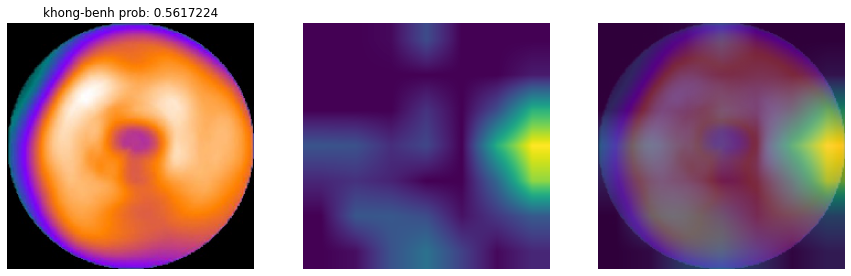

8


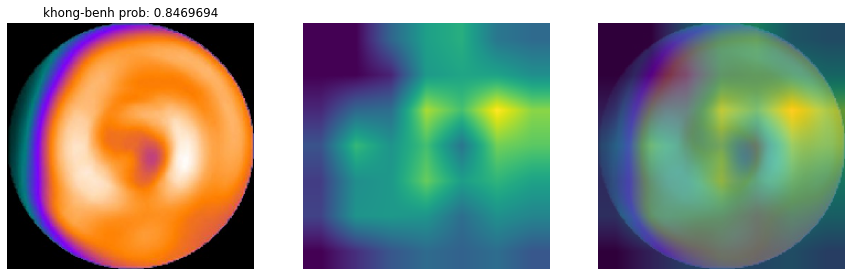

9


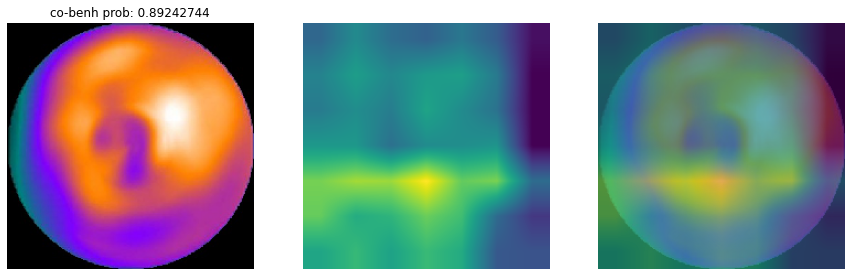

9


In [ ]:
runGrad(student_mobilenet_v2,'Conv_1')

#Distillation Resnet50V2

In [ ]:
def resnet50():
    net = tf.keras.applications.ResNet50V2(include_top=False,input_shape=(224,224,3))

    # Dong bang cac layer
    for layer in net.layers:
        layer.trainable = False

    flat1 = keras.layers.GlobalAveragePooling2D()(net.layers[-1].output)
    class1 = Dense(256, activation='relu')(flat1)
    class2 = Dropout(0.2)(class1)
    output = Dense(2, activation='softmax')(class2)
    # define new model
    model = Model(inputs=net.inputs, outputs=output)
    model.compile(loss='sparse_categorical_crossentropy', optimizer='adam', metrics=[keras.metrics.SparseCategoricalAccuracy()])
    return model

In [ ]:
resnet50 = resnet50()

94683136/94668760 [==============================] - 1s 0us/step


**Distilation**

In [ ]:
distiller = Distiller(student=resnet50, teacher=teacher)

distiller.compile(
    optimizer=keras.optimizers.Adam(),
    metrics=[keras.metrics.SparseCategoricalAccuracy()],
    student_loss_fn=keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    distillation_loss_fn=keras.losses.KLDivergence(),
    alpha=0.1,
    temperature=10,
)
# Distill teacher to student
max = 0.0
for i in range(100):
  history=distiller.fit(X_train, y_train,
                                epochs=1,validation_data=(X_test,y_test))
  eval = distiller.evaluate(X_test,y_test)
  if(eval[0]>max):
    max = eval[0]
    print("save weights"+ str(eval[0]))
    distiller.save_weights('./drive/MyDrive/Explainable/Distilltion/distiller_resnet50.hdf5')
distiller.built = True
distiller.load_weights('./drive/MyDrive/Explainable/Distilltion/distiller_resnet50.hdf5')
distiller.student.save('./drive/MyDrive/Explainable/Distilltion/distilled_resnet50.h5')

In [ ]:
distiller.student.summary()

In [ ]:
distilled_resnet50 = keras.models.load_model(filepath='./drive/MyDrive/Explainable/Distilltion/distilled_resnet50.h5')
distilled_resnet50.evaluate(X_test,y_test)
evaluate_all(distilled_resnet50)

2/2 [==============================] - 1s 62ms/step - loss: 0.3983 - sparse_categorical_accuracy: 0.9091
Overall accuracy of Neural Network model: 0.09090909090909091
[0.         0.         0.         0.69565217 0.69565217 0.73913043
 0.73913043 0.86956522 0.86956522 1.        ]
AUC_Glob:  0.9047619047619048
(44, 2)
(44,)
(44,)
Accuracy: 0.909091
Precision: 0.925926
Recall: 0.904762
F1 score: 0.907368
Specificity: 0.809524


In [ ]:
flops = get_flops(distilled_resnet50, batch_size=1)
print(f"FLOPS: {flops / 10 ** 9:.03} G")

Instructions for updating:
Use `tf.compat.v1.graph_util.tensor_shape_from_node_def_name`
FLOPS: 6.99 G


In [ ]:
predict(distilled_resnet50)

--- 0.22812724113464355 seconds ---


**Student**

In [ ]:
student = resnet50()
filepath="./drive/MyDrive/Explainable/Distilltion/student_resnet50.hdf5"
checkpoint = ModelCheckpoint(filepath, monitor='val_sparse_categorical_accuracy', verbose=1, save_best_only=True, mode='max')
callbacks_list = [checkpoint]
# Train and evaluate student trained from scratch.
student.fit(X_train, y_train,
                               epochs=100,
                               validation_data=(X_test,y_test),
                               callbacks=callbacks_list)
student.built = True
student.load_weights('./drive/MyDrive/Explainable/Distilltion/student_resnet50.hdf5')
student.save('./drive/MyDrive/Explainable/Distilltion/student_resnet50.h5')

In [ ]:
student.summary()

In [ ]:
student_resnet50 = keras.models.load_model(filepath='./drive/MyDrive/Explainable/Distilltion/student_resnet50.h5')
student_resnet50.evaluate(X_test,y_test)
evaluate_all(student_resnet50)

2/2 [==============================] - 1s 55ms/step - loss: 0.3635 - sparse_categorical_accuracy: 0.8864
Overall accuracy of Neural Network model: 0.11363636363636363
[0.         0.         0.         0.13043478 0.13043478 0.17391304
 0.17391304 0.39130435 0.39130435 0.69565217 0.69565217 0.86956522
 0.86956522 1.        ]
AUC_Glob:  0.8809523809523809
(44, 2)
(44,)
(44,)
Accuracy: 0.886364
Precision: 0.910714
Recall: 0.880952
F1 score: 0.883413
Specificity: 0.761905


In [ ]:
student_resnet50.summary()

Model: "model_22"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_23 (InputLayer)          [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_23[0][0]']               
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                           

In [ ]:
flops = get_flops(student_resnet50, batch_size=1)
print(f"FLOPS: {flops / 10 ** 9:.03} G")

FLOPS: 6.99 G


In [ ]:
predict(student_resnet50)

--- 0.22304677963256836 seconds ---


**RISE**

**Distilled**

0


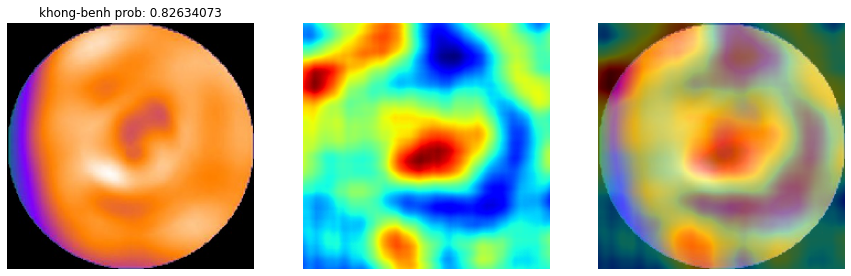

1


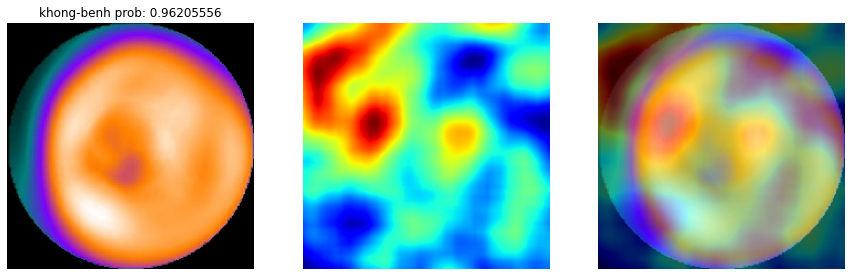

2


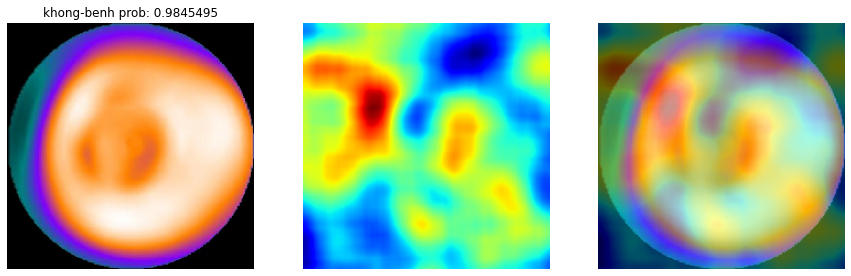

3


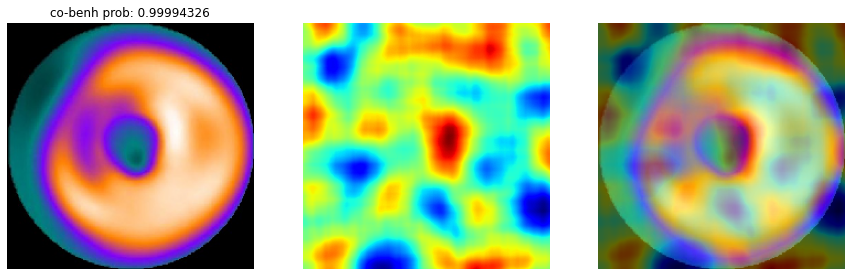

3
3
3


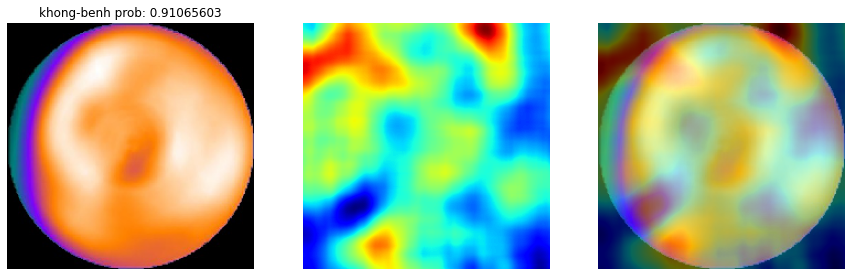

4


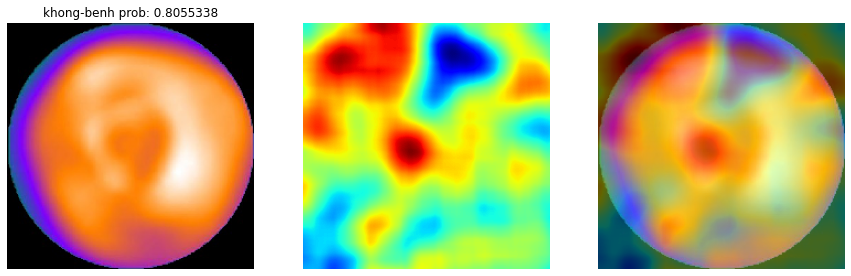

5


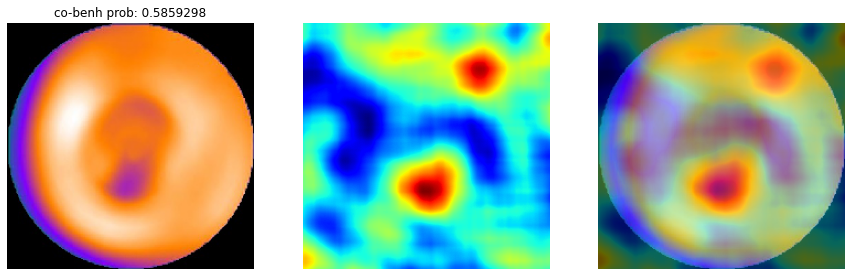

5


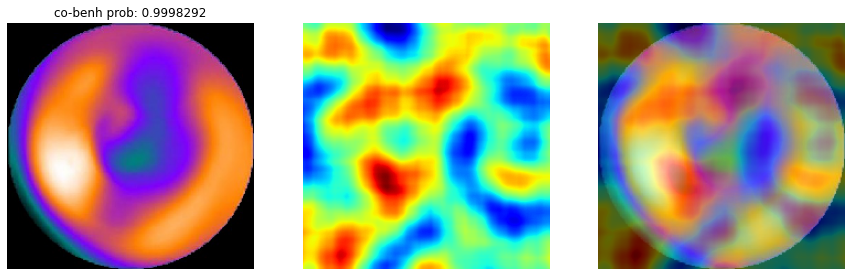

5


In [ ]:
run_rise(distilled_resnet50)

**Student**

0


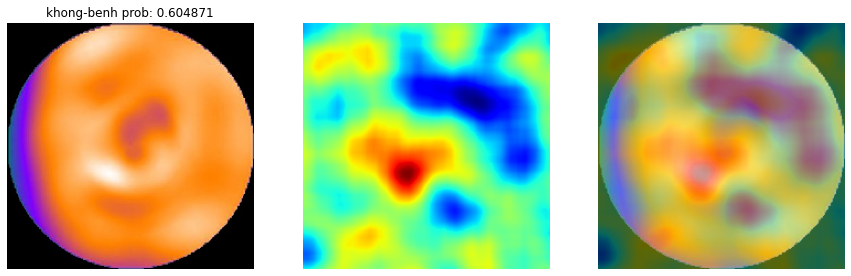

1


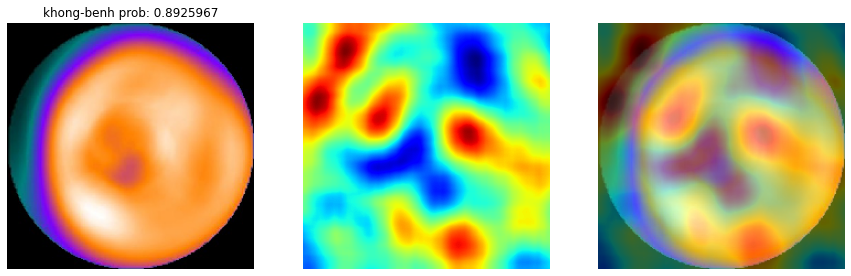

2


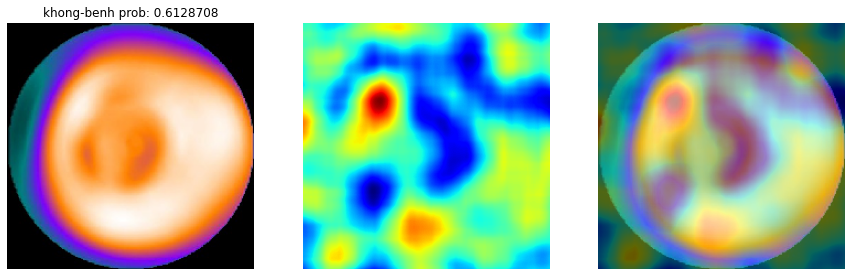

3


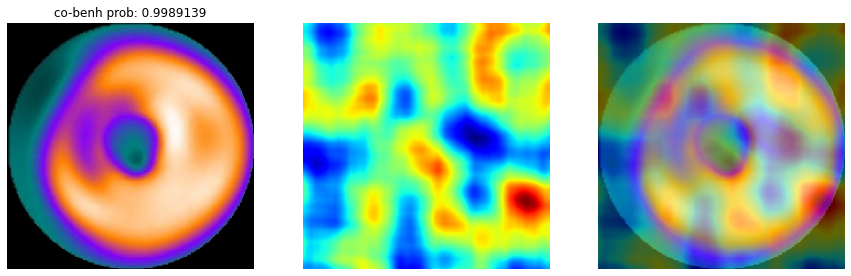

3


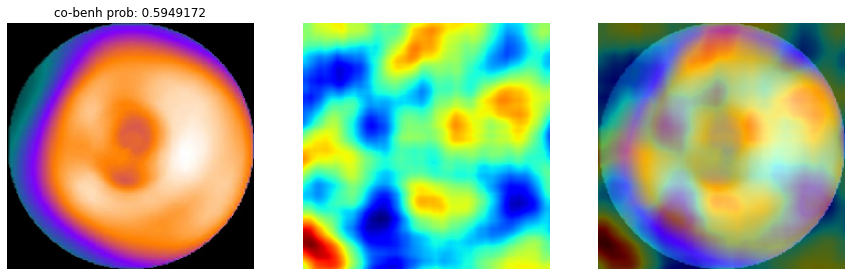

3
3


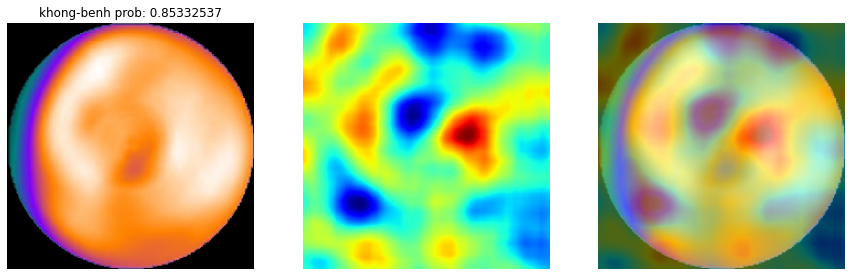

4


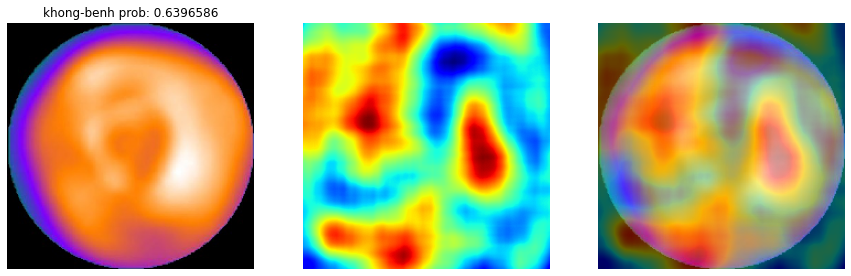

5
5


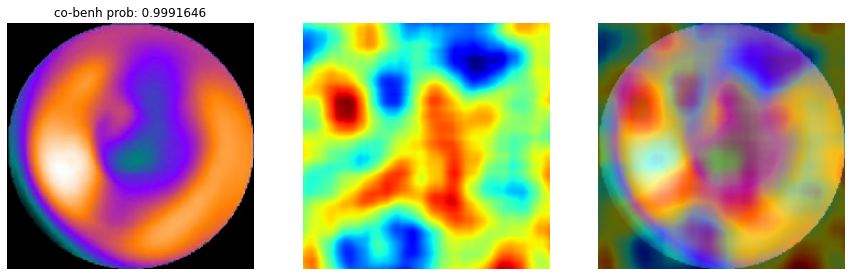

5


In [ ]:
run_rise(student_resnet50)

**LIME**

Distilled

0


  0%|          | 0/1000 [00:00<?, ?it/s]

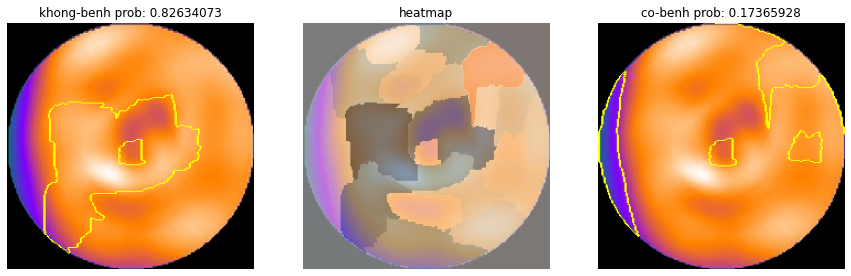

1


  0%|          | 0/1000 [00:00<?, ?it/s]

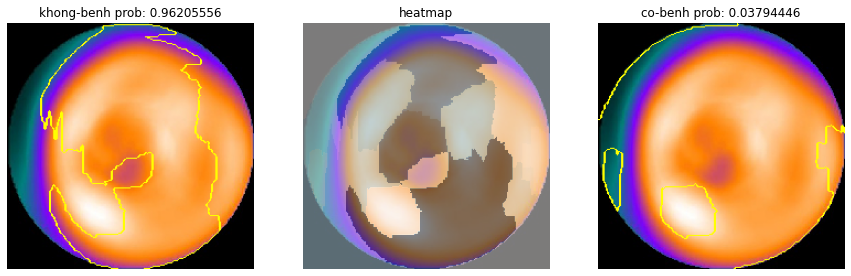

2


  0%|          | 0/1000 [00:00<?, ?it/s]

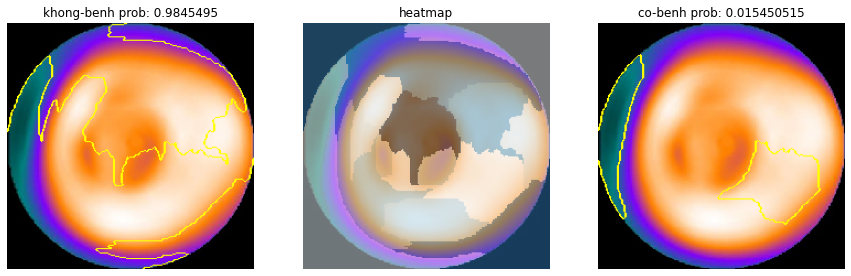

3


  0%|          | 0/1000 [00:00<?, ?it/s]

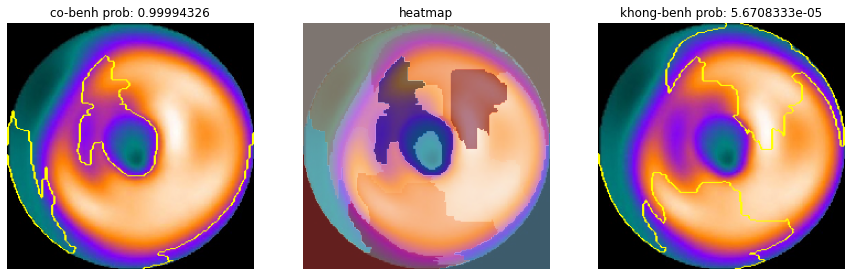

3
3
3


  0%|          | 0/1000 [00:00<?, ?it/s]

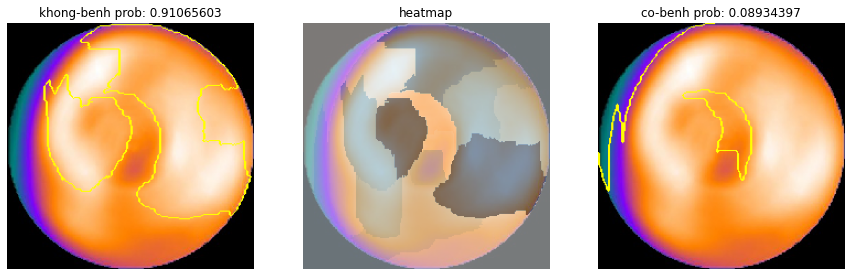

4


  0%|          | 0/1000 [00:00<?, ?it/s]

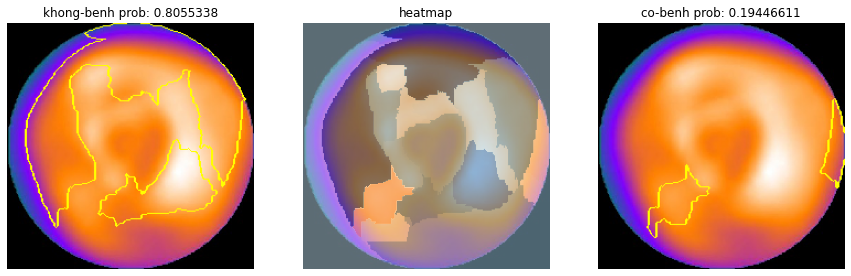

5


  0%|          | 0/1000 [00:00<?, ?it/s]

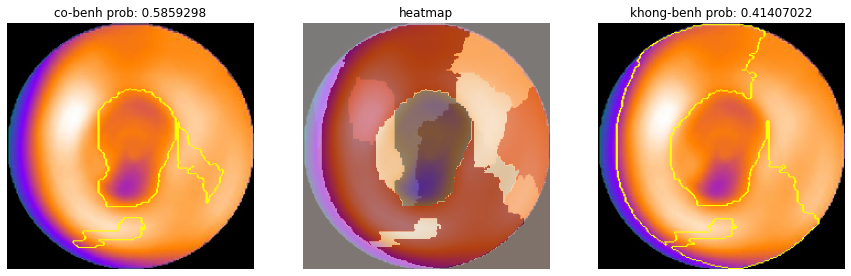

5


  0%|          | 0/1000 [00:00<?, ?it/s]

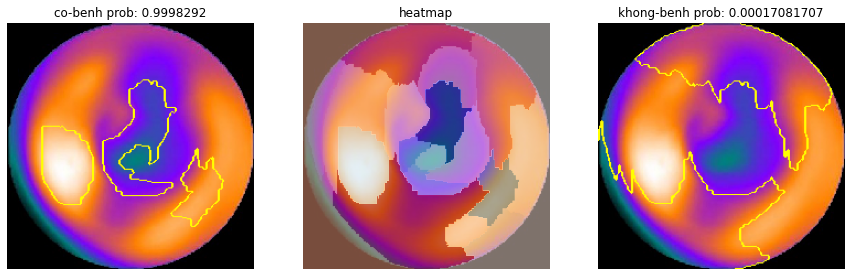

5


In [ ]:
runLime(distilled_resnet50)

**Student**

0


  0%|          | 0/1000 [00:00<?, ?it/s]

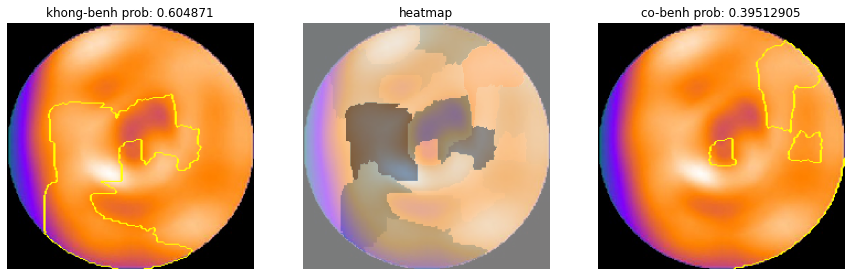

1


  0%|          | 0/1000 [00:00<?, ?it/s]

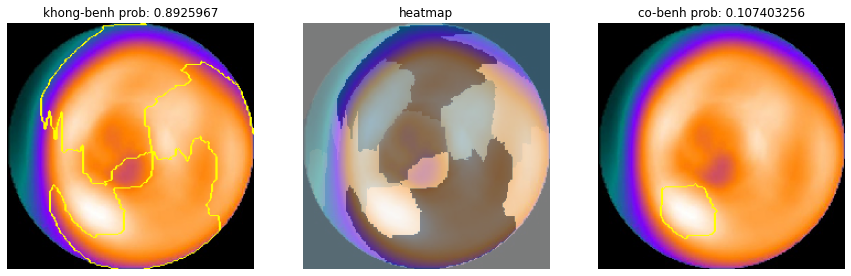

2


  0%|          | 0/1000 [00:00<?, ?it/s]

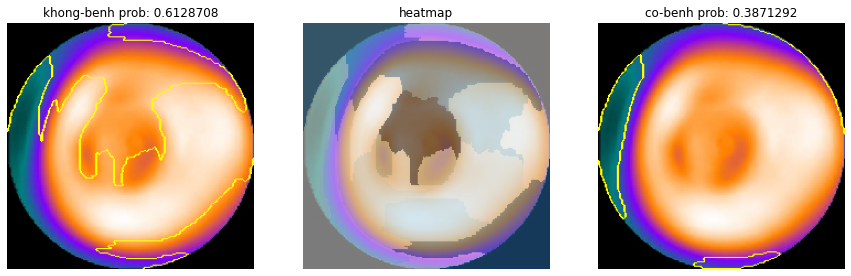

3


  0%|          | 0/1000 [00:00<?, ?it/s]

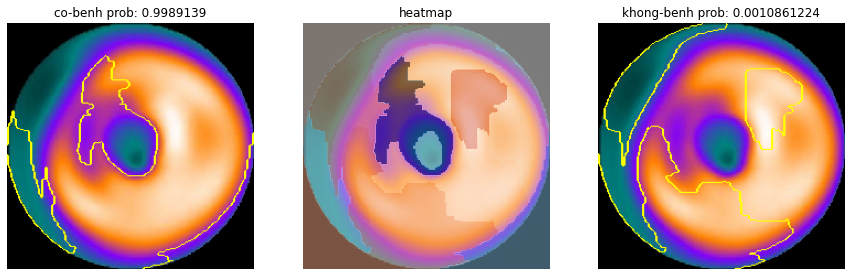

3


  0%|          | 0/1000 [00:00<?, ?it/s]

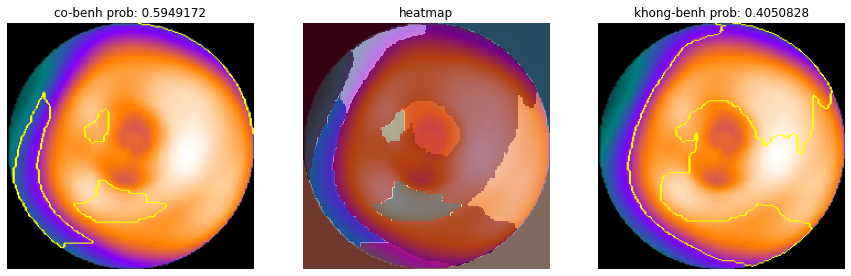

3
3


  0%|          | 0/1000 [00:00<?, ?it/s]

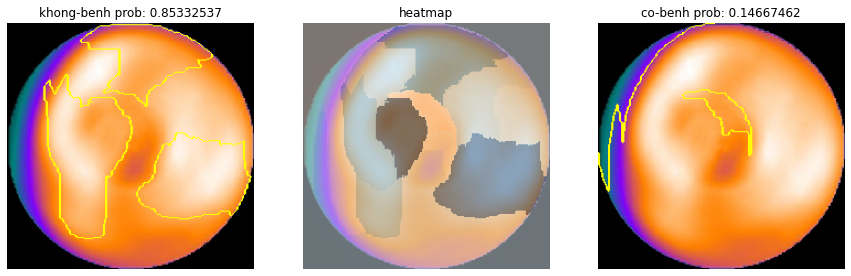

4


  0%|          | 0/1000 [00:00<?, ?it/s]

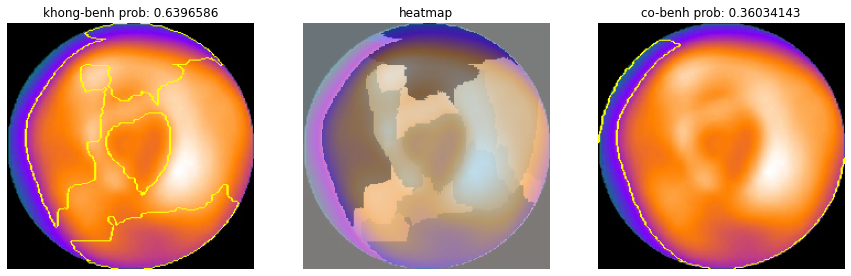

5
5


  0%|          | 0/1000 [00:00<?, ?it/s]

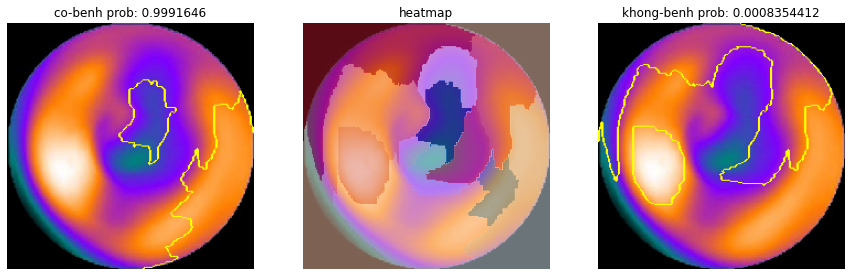

5


In [ ]:
runLime(student_resnet50)

**GradCam**

**Distilled**

0


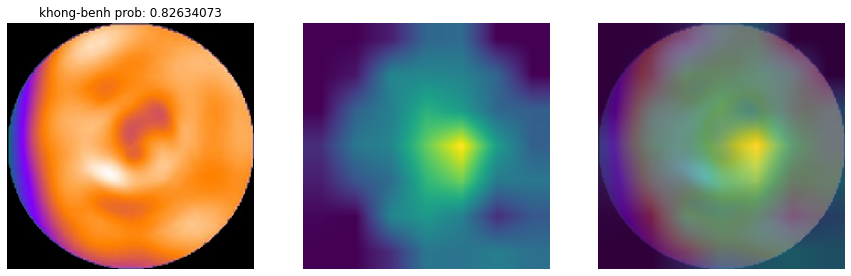

1


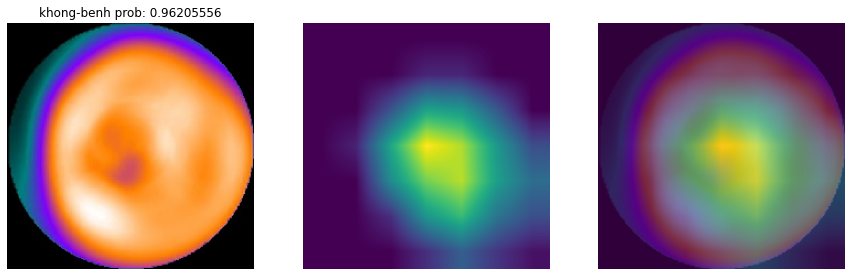

2


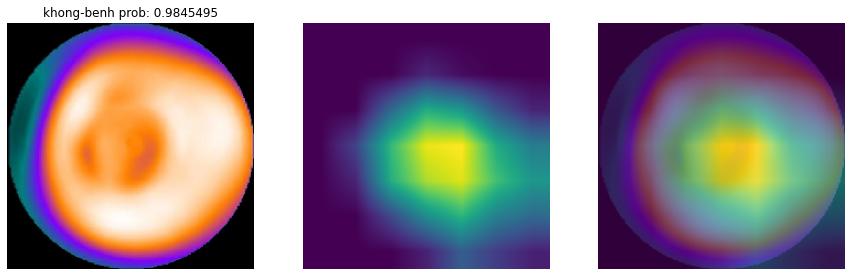

3


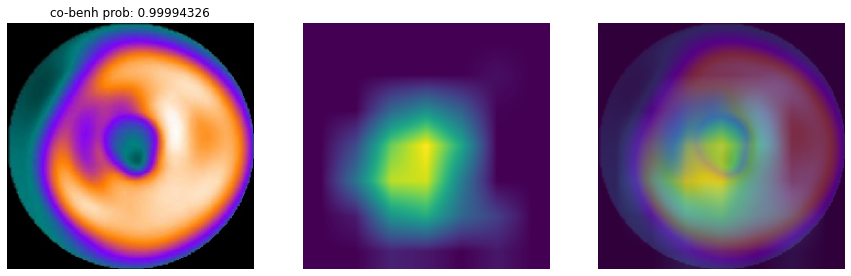

3
3
3


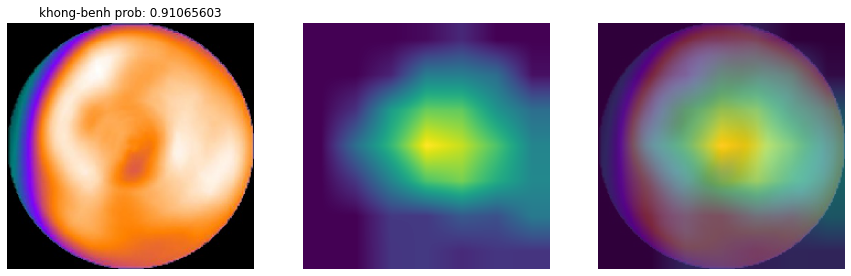

4


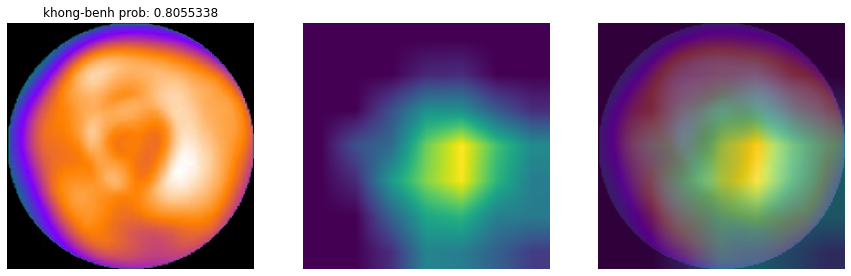

5


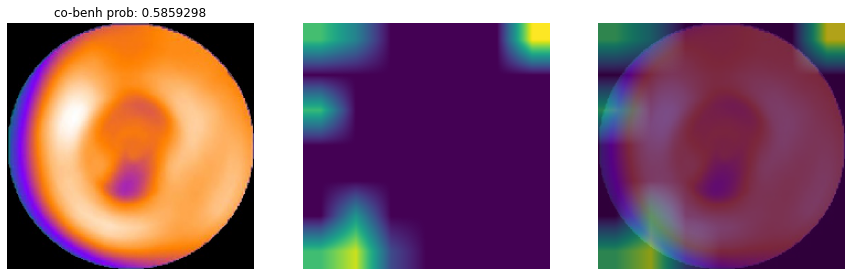

5


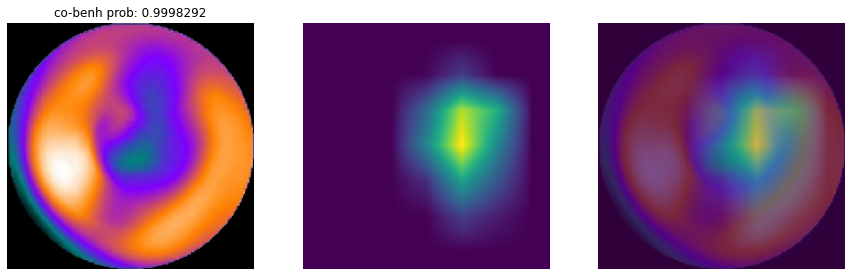

5


In [ ]:
runGrad(distilled_resnet50, 'conv5_block3_out') 

**Student**

0


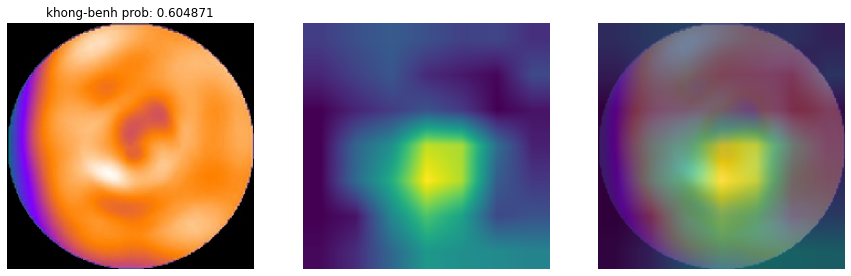

1


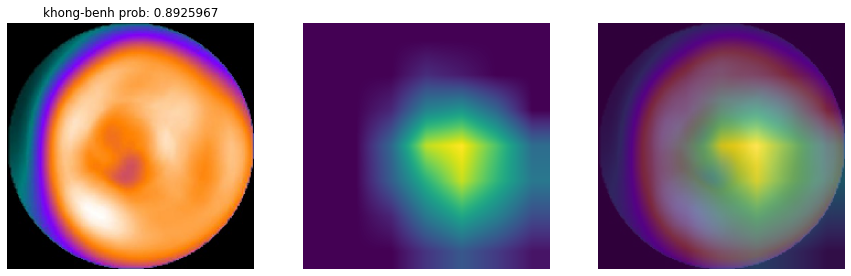

2


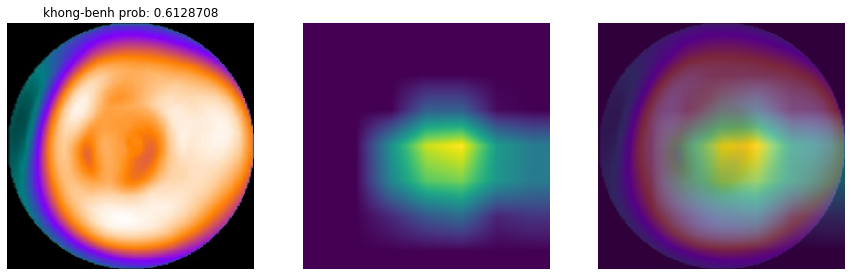

3


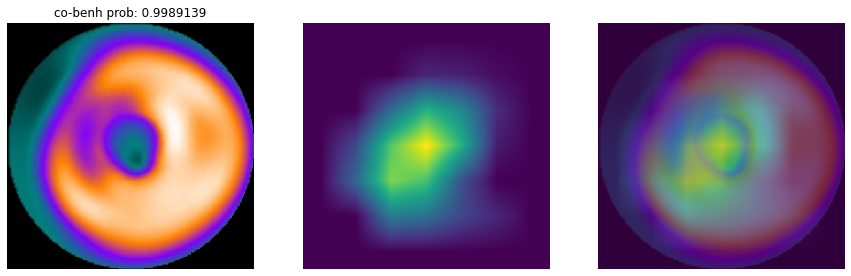

3


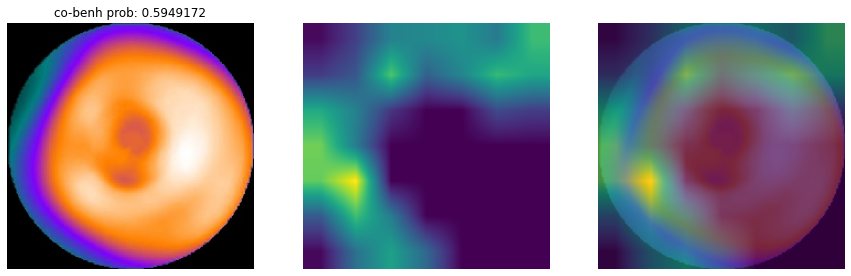

3
3


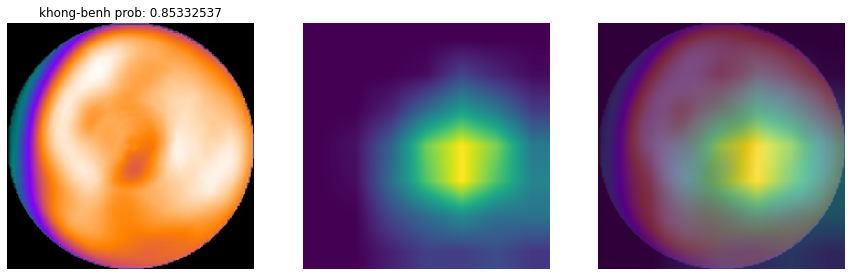

4


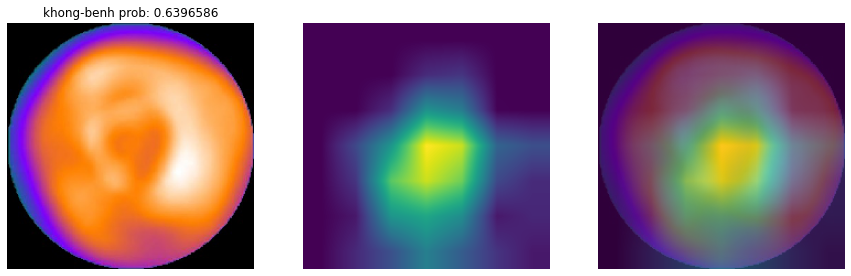

5
5


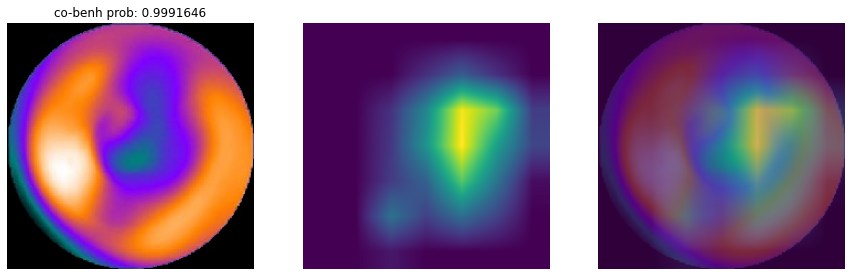

5


In [ ]:
runGrad(student_resnet50, 'conv5_block3_out') 

#Teacher model

0


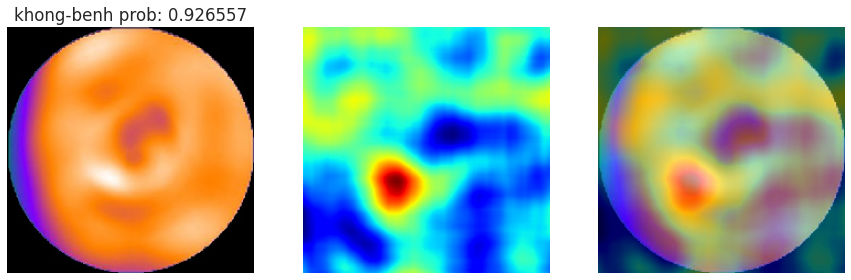

1


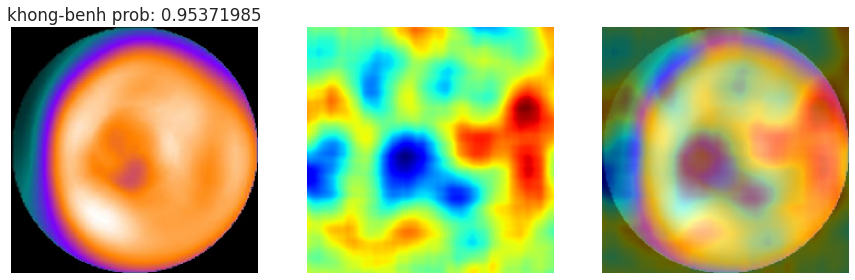

2


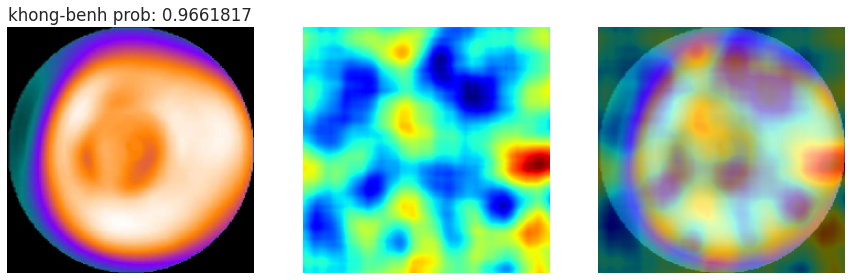

3


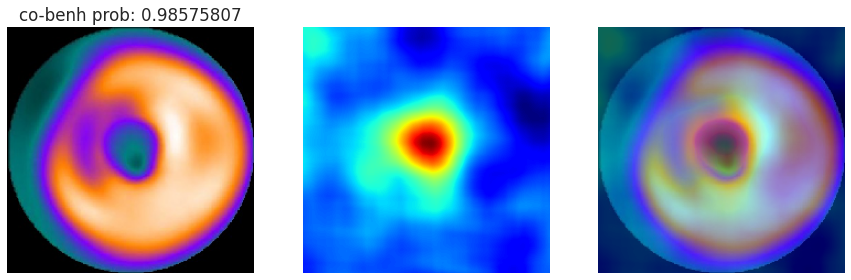

3
3
3


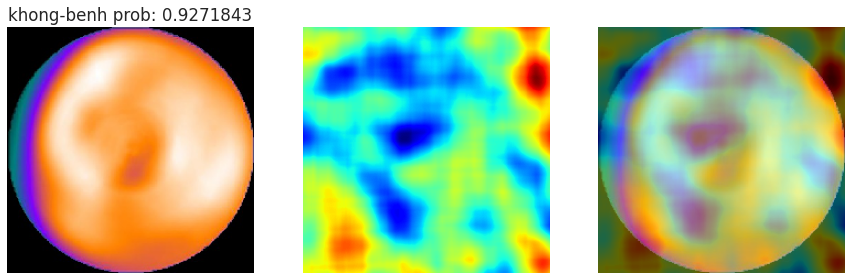

4


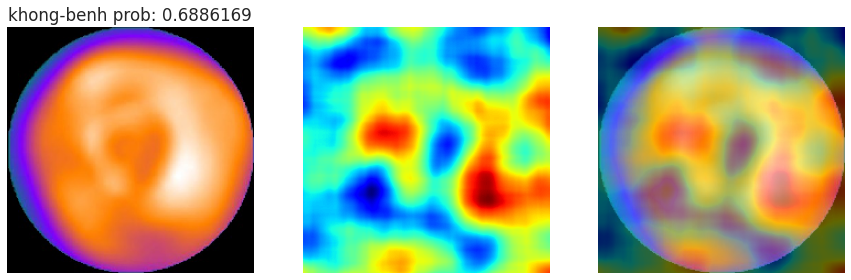

5


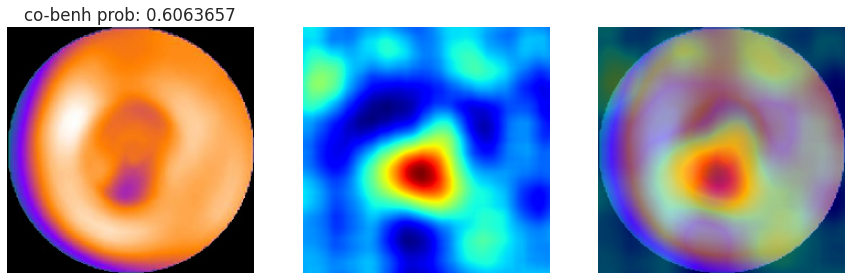

5


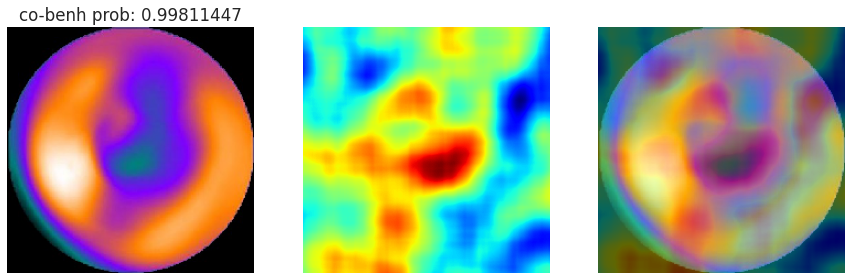

5


In [ ]:
run_rise(teacher)

In [ ]:
runLime(teacher)